In [ ]:
!pip install noisereduce

In [ ]:
import os
import librosa
import numpy as np
import soundfile as sf
import IPython.display as ipd
import matplotlib.pyplot as plt
from scipy.io import wavfile
import noisereduce as nr

import pandas as pd
import seaborn as sn
import librosa
import os
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.svm import LinearSVC
import keras.activations,keras.losses,keras.optimizers

Dataset audio asli dapat diakses pada link berikut:

*   Github : https://github.com/salsabilaseptiani/Deepfake-Audio-Detection
*   Onedrive : https://unairacid-my.sharepoint.com/:f:/g/personal/salsabila_dwi_septiani-2021_ftmm_drive_unair_ac_id/ErGa8ASHsjlJvXs12Wo1QxgBiEQhYFj79cbwtAc7qvuNNw?e=ZV7k7s



# Preprocessing

In [ ]:
# Load the dataset
data = pd.read_csv("https://raw.githubusercontent.com/salsabilaseptiani/Deepfake-Audio-Detection/main/combined_prepro.csv?token=GHSAT0AAAAAACLOW2SKH4VVERB7HNRCP2MSZMSW23Q")
data

,chroma_stft,rms,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc_1,mfcc_2,mfcc_3,mfcc_4,...,mfcc_12,mfcc_13,mfcc_14,mfcc_15,mfcc_16,mfcc_17,mfcc_18,mfcc_19,mfcc_20,label
0,0.324920,0.022398,2084.217421,1218.086758,3153.674052,0.137449,-491.60742,67.972470,8.536622,21.484945,...,-4.801095,-5.523870,-8.844734,-6.075182,-3.269737,-8.045405,-7.596706,-8.414668,-8.675213,REAL
1,0.327827,0.023922,1951.786090,1441.156772,3205.859620,0.109158,-488.43848,61.403545,26.003710,25.890429,...,-2.667724,-1.736412,-9.767786,-6.627184,-3.890561,-8.537563,-5.036344,-9.781763,-8.757393,REAL
2,0.337789,0.029765,1806.766189,1376.168877,2813.194839,0.108056,-458.50540,69.966620,-1.625244,-0.825355,...,-7.278201,-8.734935,-4.479663,-8.899043,-11.846470,-9.573208,-8.740530,-5.834911,-4.337790,REAL
3,0.314905,0.030108,1732.684715,1017.022465,2634.056561,0.118669,-490.27414,68.099464,23.988298,20.310532,...,-2.590399,-5.282260,-9.143073,-7.583701,-7.943367,-7.105860,-2.420488,-10.324329,-9.542696,REAL
4,0.317812,0.022042,1707.295043,1381.487939,2859.374376,0.104581,-473.54895,55.865524,14.974690,18.821589,...,-4.733916,-3.424912,-9.601941,-7.274724,-3.182179,-7.863845,-5.290977,-9.733001,-10.232399,REAL
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
296,0.336872,0.026558,2881.704900,1112.049112,3787.185433,0.182751,-478.82410,69.803550,6.171349,12.593709,...,-7.853964,-5.935065,-1.488504,-5.120705,-5.278588,-4.527907,-2.952554,-4.789183,-3.091937,FAKE
297,0.363560,0.030242,2791.599751,1060.886999,3638.328000,0.197138,-464.54703,77.793850,14.551519,20.366510,...,-4.539271,-1.027358,-5.204325,-3.324449,3.569290,-3.792161,-4.680034,-0.015627,-2.374291,FAKE
298,0.348819,0.027814,2589.931139,1214.467791,3569.778414,0.177582,-477.19785,69.805310,0.496686,14.947964,...,-2.140995,-7.401273,-1.898863,-0.866470,-6.263555,-4.896846,-0.649697,-5.772592,-2.808235,FAKE
299,0.381720,0.026571,2730.036186,1147.012889,3617.694791,0.156884,-486.63672,80.136700,14.384768,21.004011,...,-2.243758,-1.189394,-3.959264,1.739053,2.439237,-3.098556,-1.928220,0.559953,-1.720671,FAKE


In [ ]:
# @title visualisasi sebelum preprocessing
def classify_features(df):
    categorical_features = []
    non_categorical_features = []
    discrete_features = []
    continuous_features = []

    for column in df.columns:
        if df[column].dtype == 'object':
            if df[column].nunique() < 10:
                categorical_features.append(column)
            else:
                non_categorical_features.append(column)
        elif df[column].dtype in ['int64', 'float64']:
            if df[column].nunique() < 10:
                discrete_features.append(column)
            else:
                continuous_features.append(column)

    return categorical_features, non_categorical_features, discrete_features, continuous_features
categorical, non_categorical, discrete, continuous = classify_features(data)

print("Categorical Features:", categorical)
print("Non-Categorical Features:", non_categorical)
print("Discrete Features:", discrete)
print("Continuous Features:", continuous)

Categorical Features: ['label']
Non-Categorical Features: []
Discrete Features: []
Continuous Features: ['chroma_stft', 'rms', 'spectral_centroid', 'spectral_bandwidth', 'rolloff', 'zero_crossing_rate', 'mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8', 'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20']


In [ ]:
for i in categorical:
    print(i,':', data[i].unique())
    print()

label : ['REAL' 'FAKE']



In [ ]:
for i in categorical:
    print(data[i].value_counts())
    print()

FAKE    151
REAL    150
Name: label, dtype: int64



<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


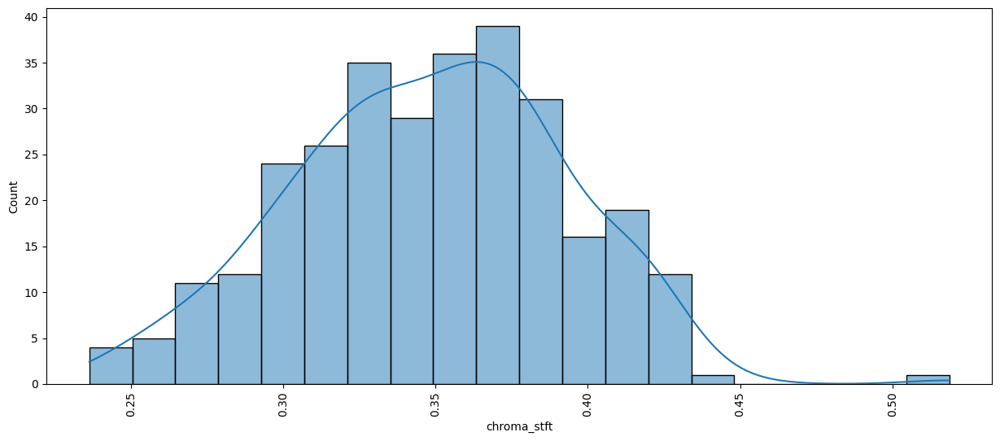

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


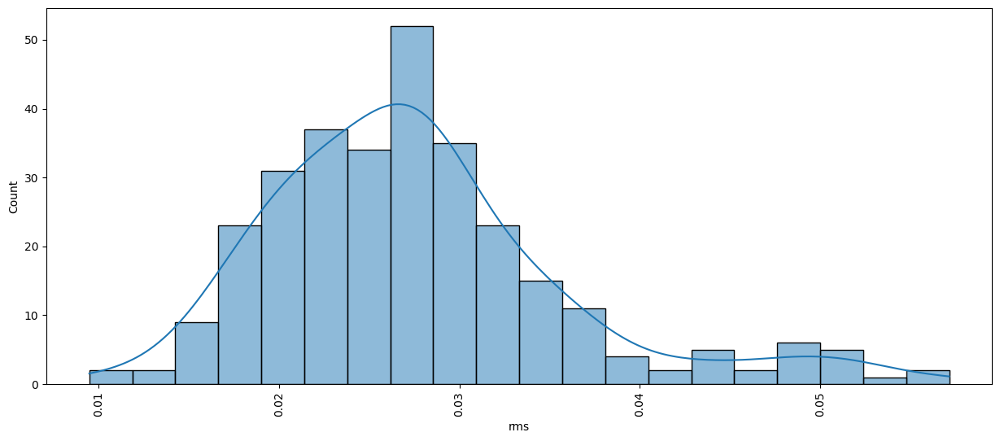

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


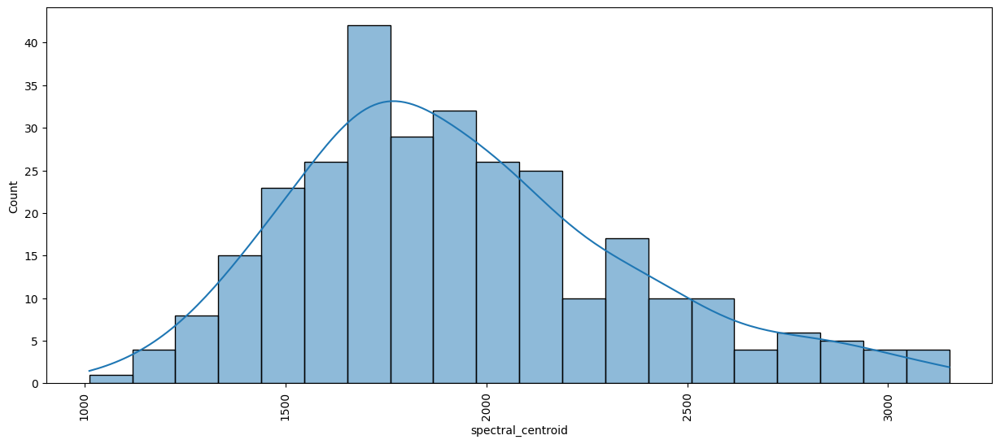

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


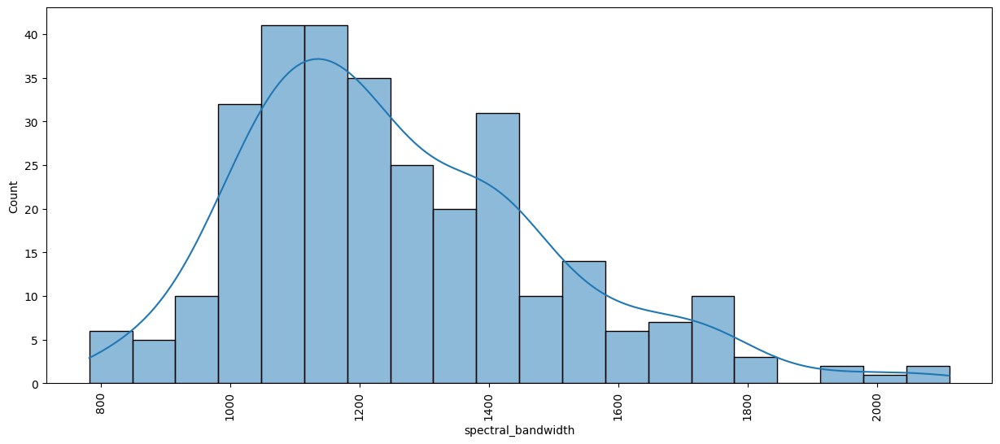

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


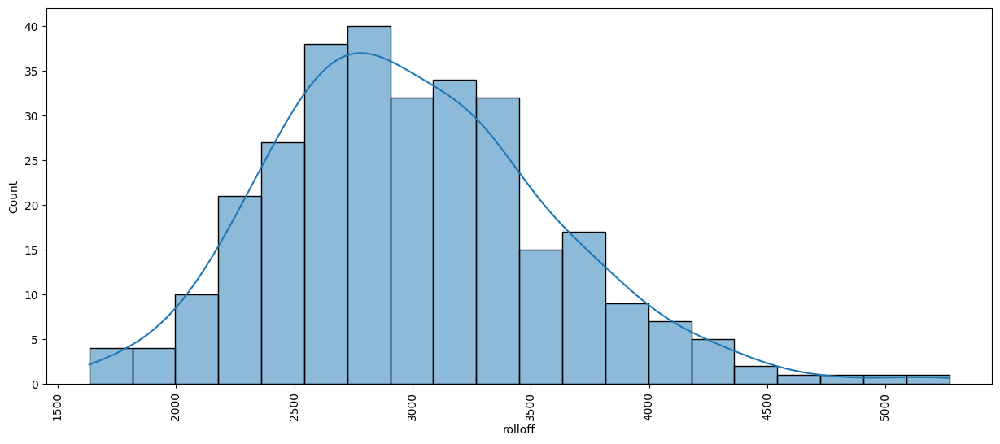

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


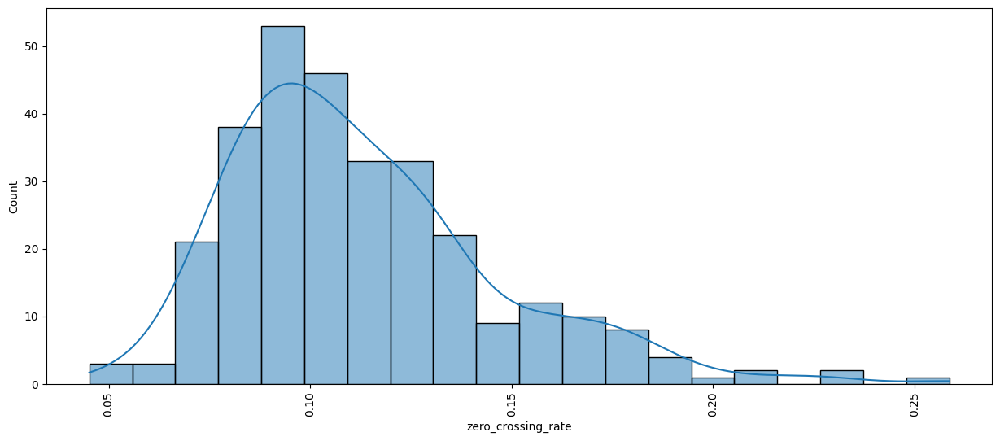

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


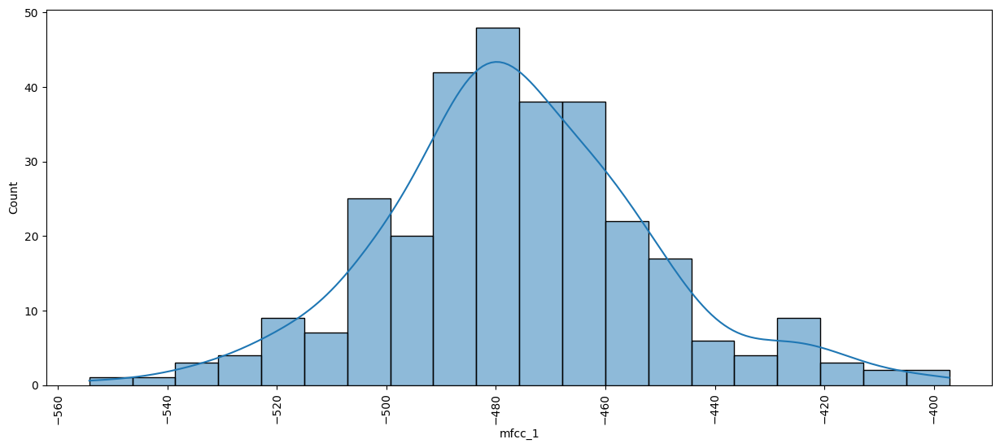

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


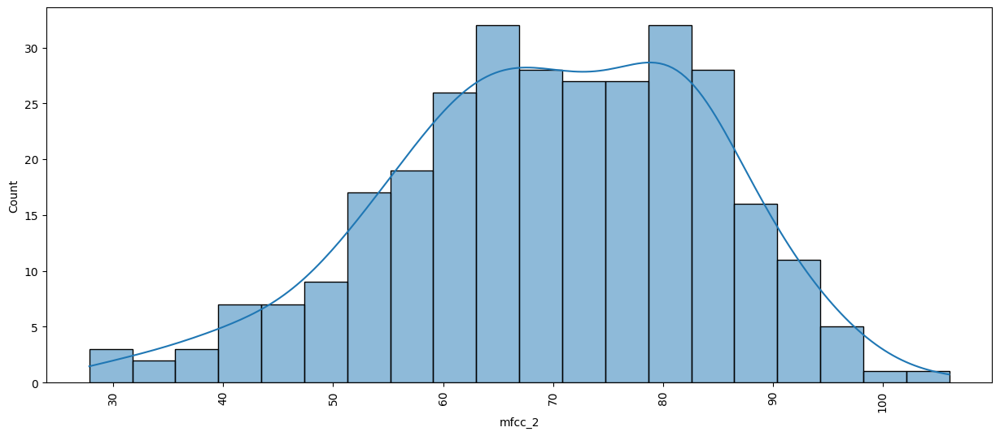

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


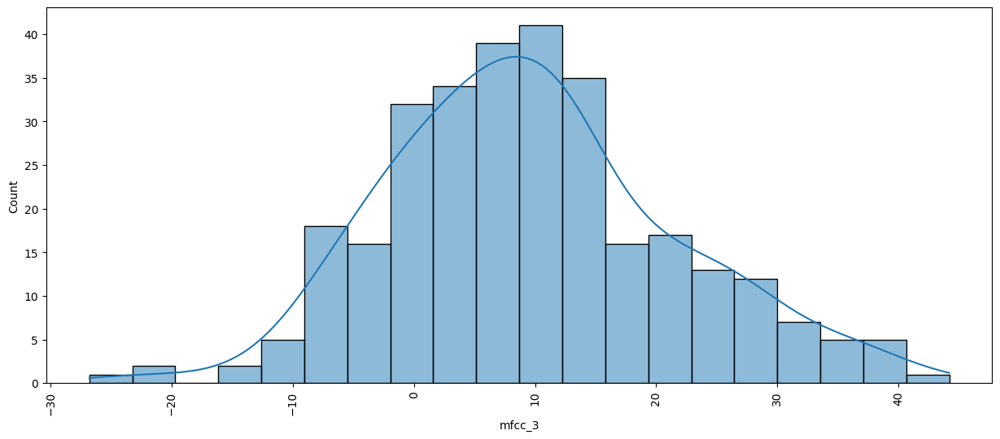

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


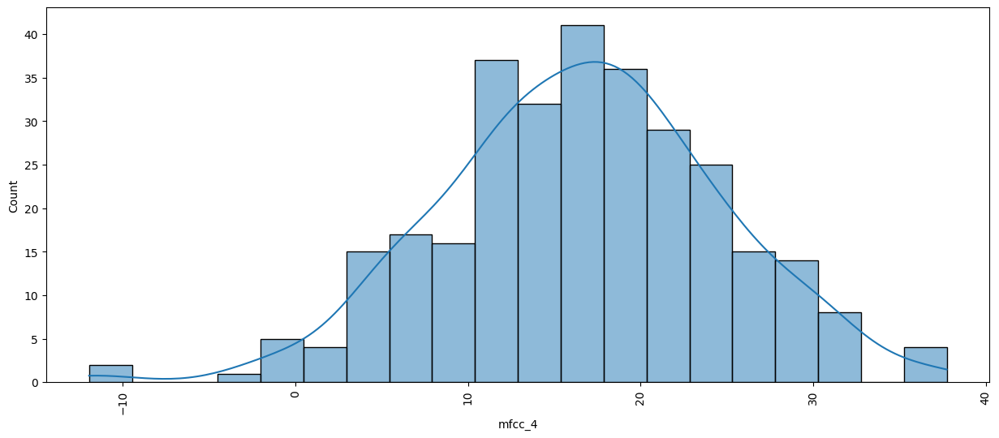

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


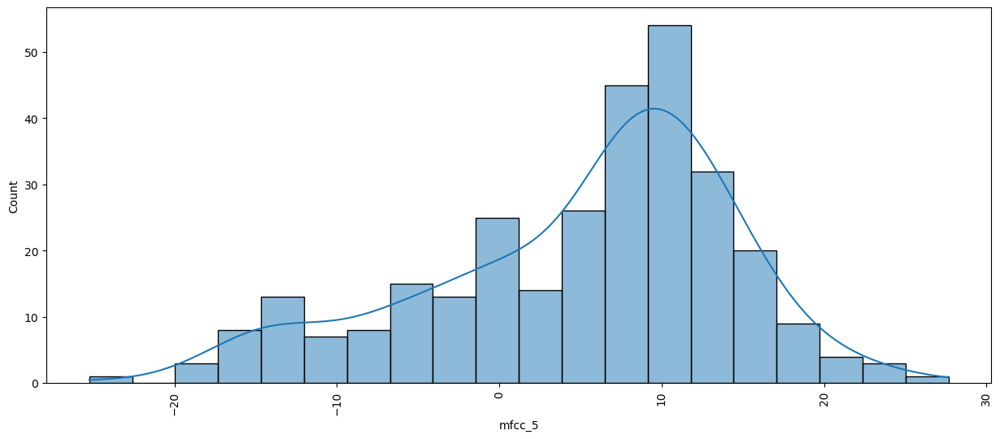

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


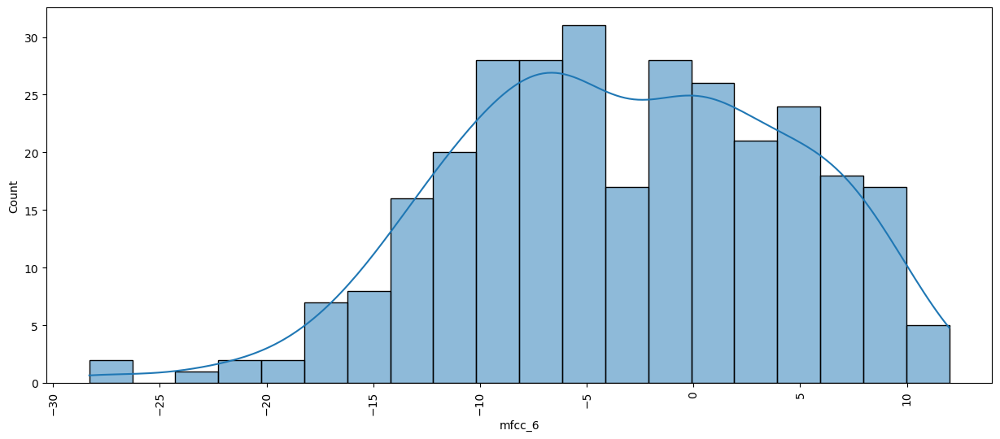

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


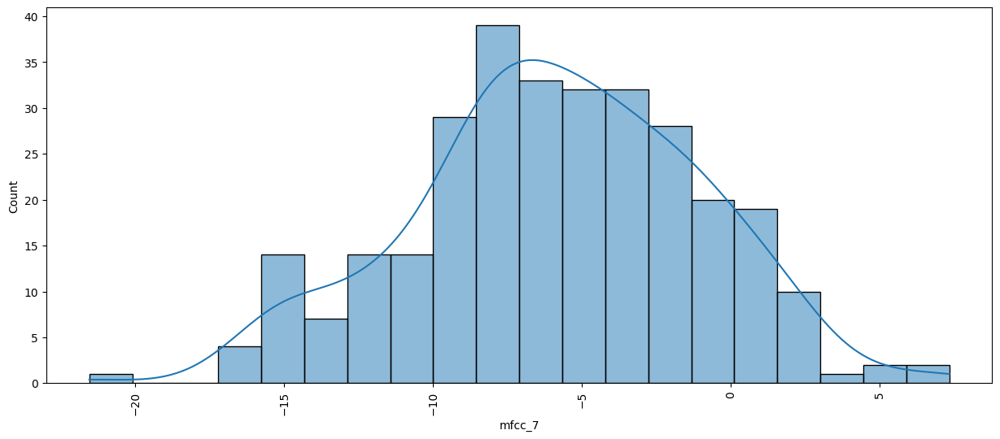

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


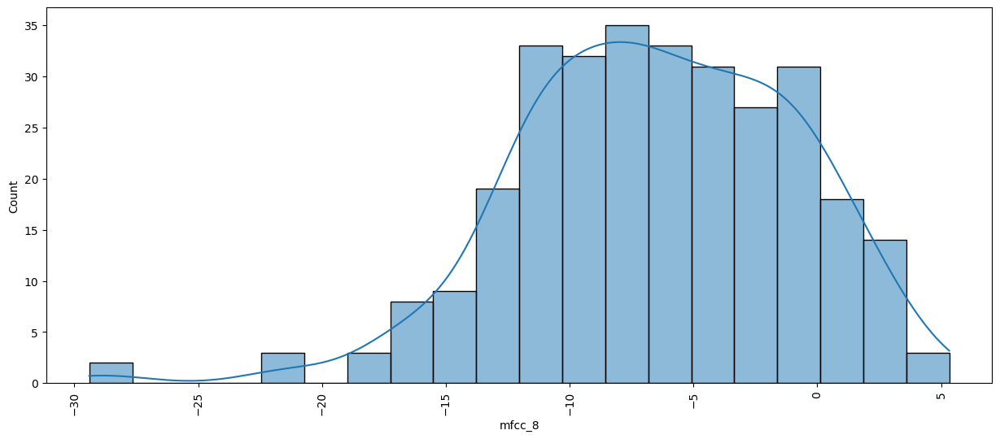

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


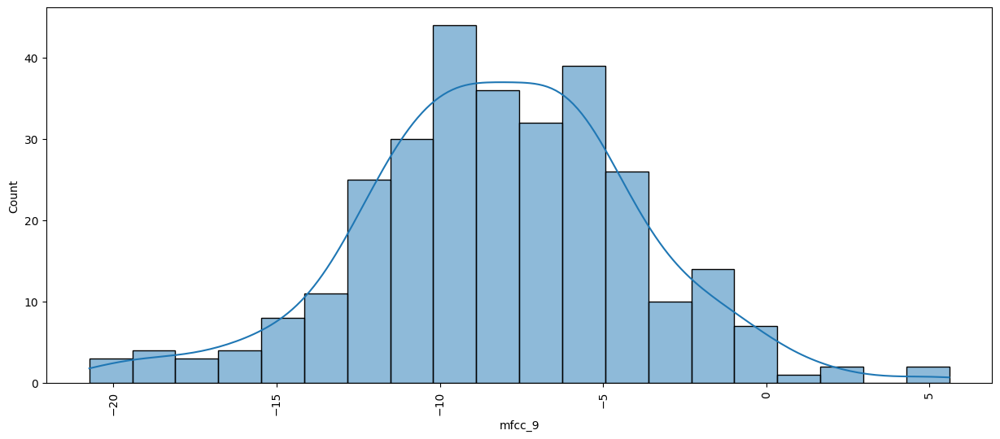

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


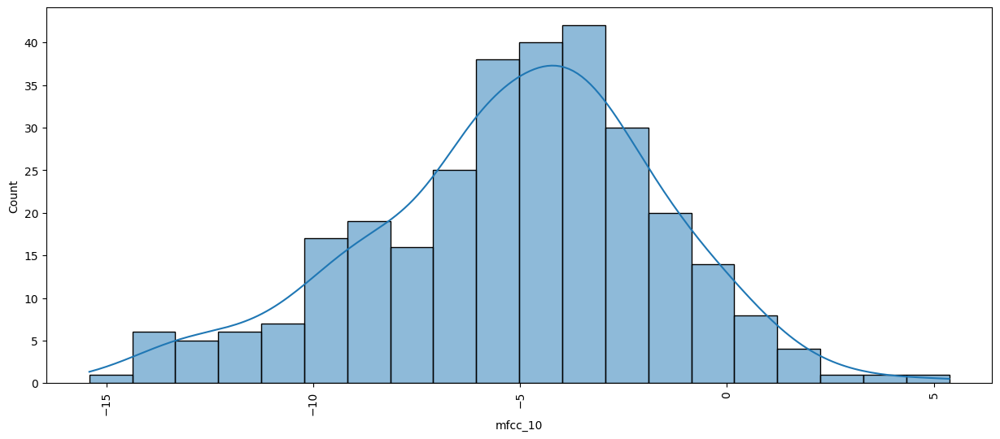

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


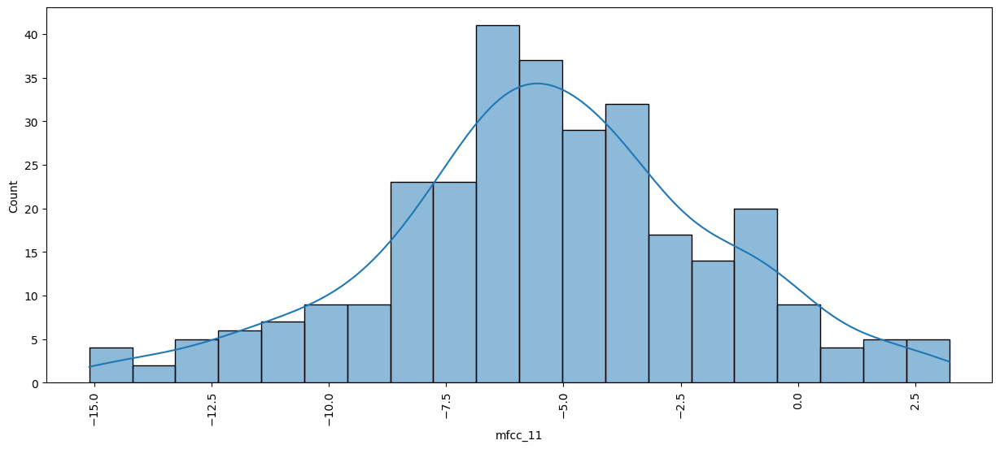

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


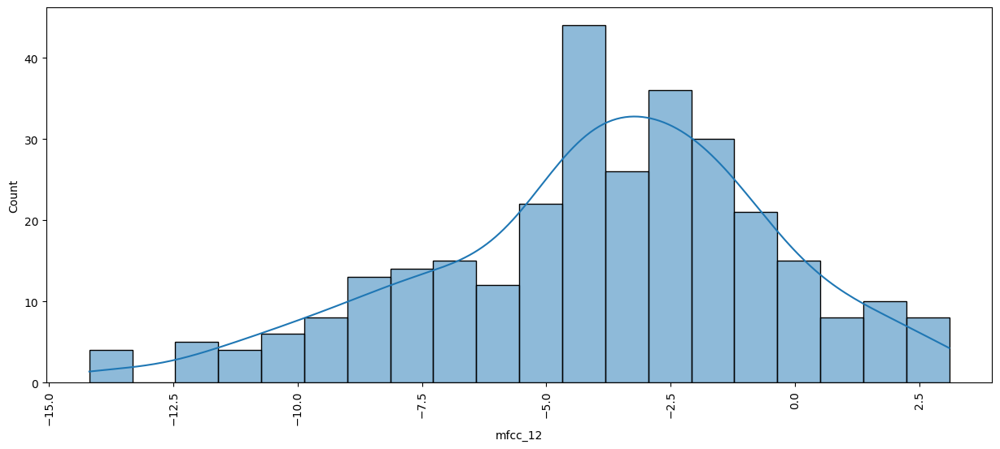

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


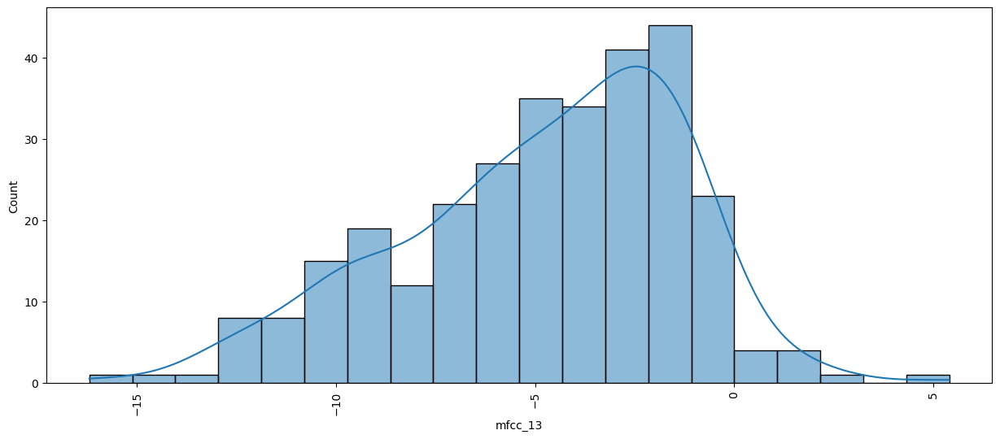

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


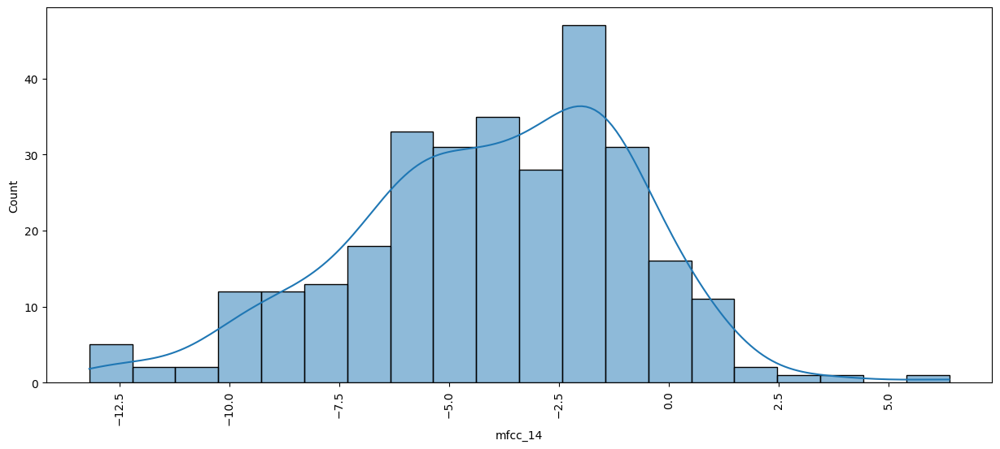

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


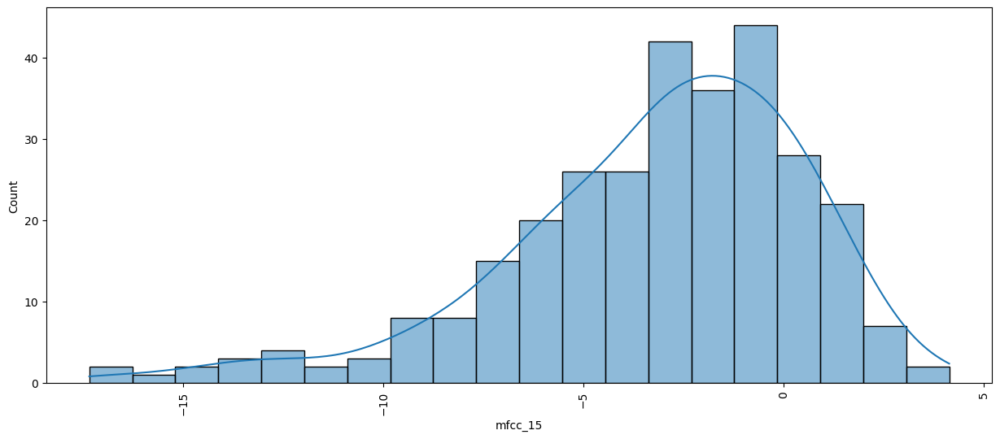

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


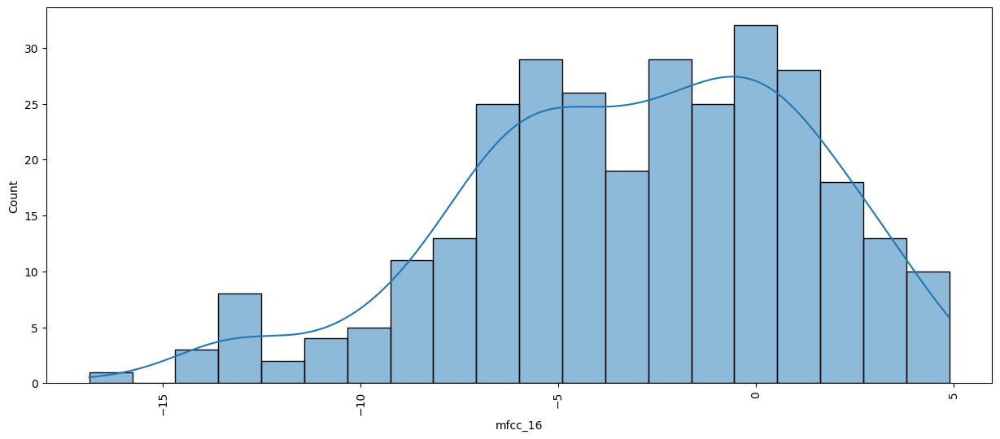

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


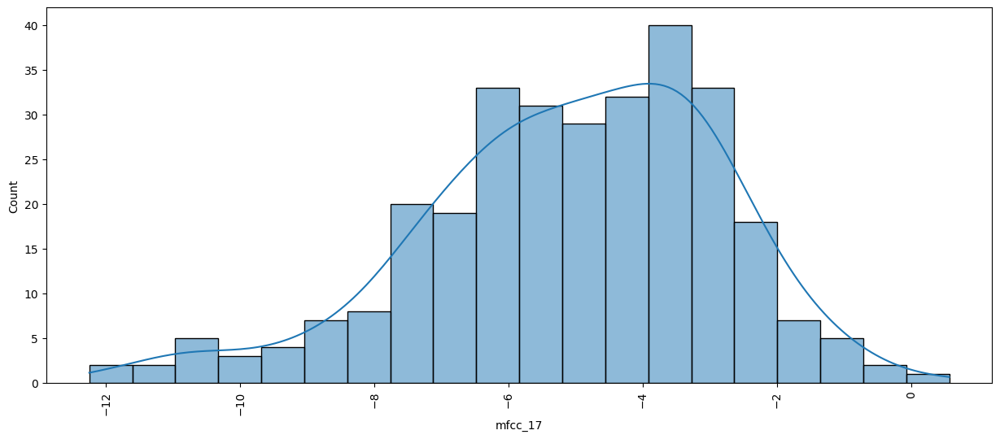

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


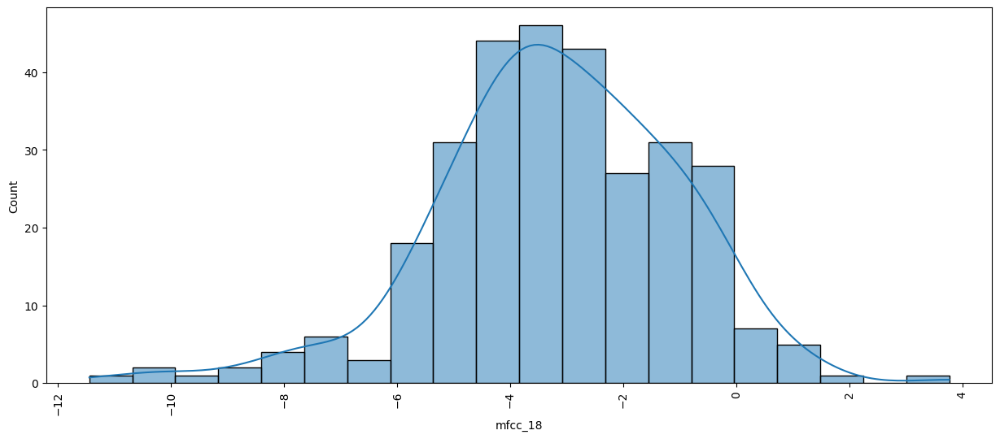

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


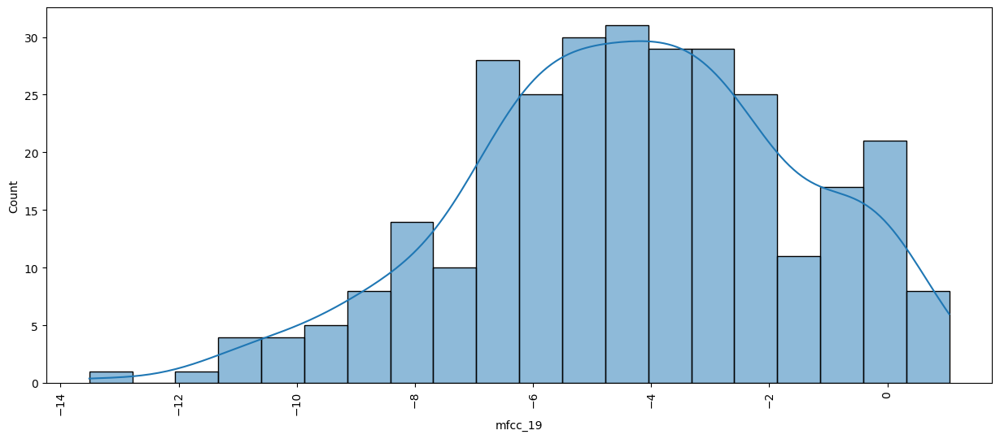

<ipython-input-77-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


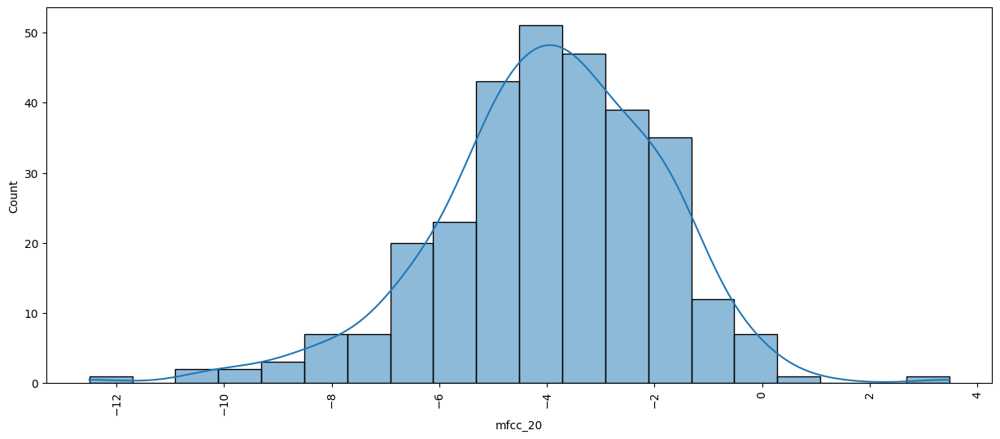

In [ ]:
for i in continuous:
    plt.figure(figsize=(15,6))
    sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')
    plt.xticks(rotation = 90)
    plt.show()

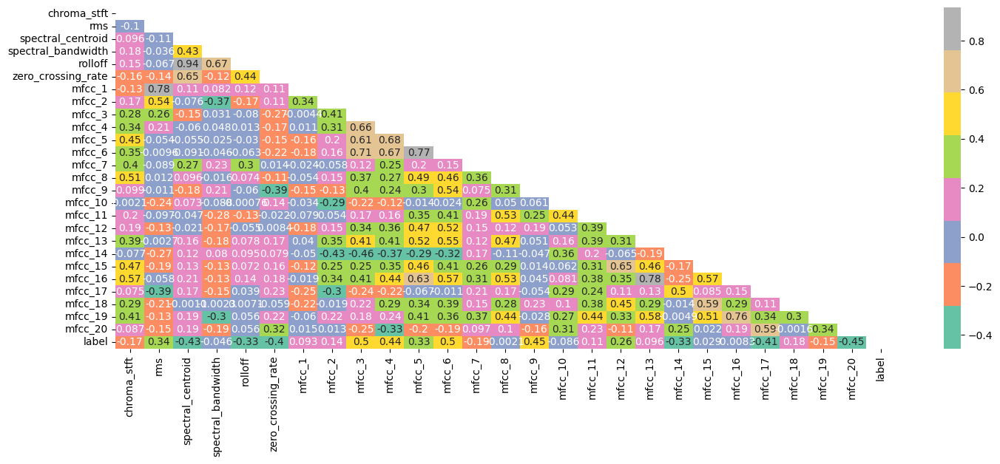

In [ ]:
lab=LabelEncoder()
for i in data.select_dtypes(include='object').columns.values:
    data[i]=lab.fit_transform(data[i])

plt.figure(figsize=(17, 6))
corr = data.corr(method='spearman')
my_m = np.triu(corr)
sn.heatmap(corr, mask=my_m, annot=True, cmap="Set2")
plt.show()

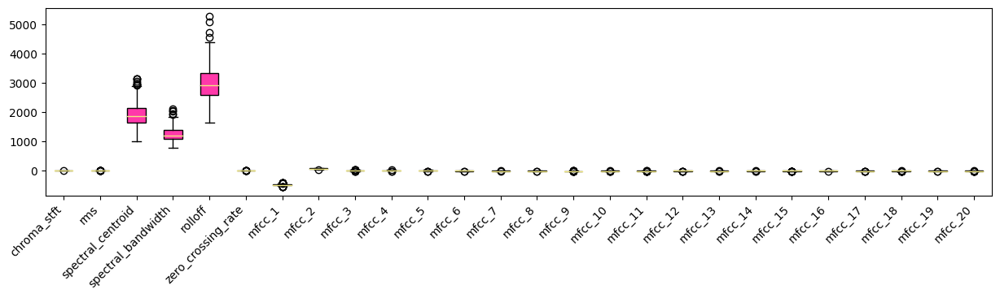

In [ ]:
# Mengabaikan kolom terakhir
X = data.iloc[:, :-1]

# Membuat figure dan axis dengan ukuran yang sesuai
fig, ax = plt.subplots(figsize=(15, 3))

# Menetapkan warna boxplot dan median
boxplot = ax.boxplot(X.values, patch_artist=True, boxprops=dict(facecolor='#ff39aa'), medianprops=dict(color='#F1E981'))

# Menetapkan label tick pada sumbu x
labels = X.columns
ax.set_xticklabels(labels, rotation=45, ha="right")

# Menampilkan plot
plt.show()

banyak outlier terlihat dan tipe data tidak sama

In [ ]:
# @title handling outlier
noise={}
for i in data.select_dtypes(include='number').columns.values:
    data['z-scores']=(data[i]-data[i].mean())/(data[i].std())
    out=np.abs(data['z-scores'] > 3)
    if out.sum() >0:
        noise[i]=out.sum()

thresh=2.5
for i in noise:
    upper=data[i].mean()+thresh*data[i].std()
    lower=data[i].mean()-thresh*data[i].std()
    data=data[(data[i]>lower)&(data[i]<upper)]

In [ ]:
data

,chroma_stft,rms,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc_1,mfcc_2,mfcc_3,mfcc_4,...,mfcc_13,mfcc_14,mfcc_15,mfcc_16,mfcc_17,mfcc_18,mfcc_19,mfcc_20,label,z-scores
0,0.324920,0.022398,2084.217421,1218.086758,3153.674052,0.137449,-491.60742,67.972470,8.536622,21.484945,...,-5.523870,-8.844734,-6.075182,-3.269737,-8.045405,-7.596706,-8.414668,-8.675213,REAL,-2.275940
1,0.327827,0.023922,1951.786090,1441.156772,3205.859620,0.109158,-488.43848,61.403545,26.003710,25.890429,...,-1.736412,-9.767786,-6.627184,-3.890561,-8.537563,-5.036344,-9.781763,-8.757393,REAL,-2.315552
5,0.372193,0.026903,1490.980017,1244.029735,2459.735796,0.086253,-474.76428,86.995840,27.216263,26.233540,...,-1.313009,-7.418168,-4.492465,-0.963964,-6.549389,-1.320657,-3.850734,-6.508279,REAL,-1.231447
6,0.416239,0.026938,1012.528388,847.593534,1633.740121,0.064838,-492.86060,94.039790,26.763243,18.370909,...,-2.454941,-6.055437,-2.958837,-2.018763,-5.894632,-4.833007,-3.194210,-4.481798,REAL,-0.254654
9,0.423071,0.018497,1459.784929,1113.109192,2413.923657,0.089022,-517.40906,80.948845,24.430130,30.220325,...,-3.380500,-4.978578,1.200603,-0.018859,-3.374609,-0.674911,-3.282418,-5.092885,REAL,-0.549207
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
296,0.336872,0.026558,2881.704900,1112.049112,3787.185433,0.182751,-478.82410,69.803550,6.171349,12.593709,...,-5.935065,-1.488504,-5.120705,-5.278588,-4.527907,-2.952554,-4.789183,-3.091937,FAKE,0.415279
297,0.363560,0.030242,2791.599751,1060.886999,3638.328000,0.197138,-464.54703,77.793850,14.551519,20.366510,...,-1.027358,-5.204325,-3.324449,3.569290,-3.792161,-4.680034,-0.015627,-2.374291,FAKE,0.761195
298,0.348819,0.027814,2589.931139,1214.467791,3569.778414,0.177582,-477.19785,69.805310,0.496686,14.947964,...,-7.401273,-1.898863,-0.866470,-6.263555,-4.896846,-0.649697,-5.772592,-2.808235,FAKE,0.552027
299,0.381720,0.026571,2730.036186,1147.012889,3617.694791,0.156884,-486.63672,80.136700,14.384768,21.004011,...,-1.189394,-3.959264,1.739053,2.439237,-3.098556,-1.928220,0.559953,-1.720671,FAKE,1.076249


In [ ]:
# @title labelling
lab=LabelEncoder()
for i in data.select_dtypes(include="object").columns.values:
    data[i]=lab.fit_transform(data[i])
data = data.drop('z-scores', axis = 1)
data

,chroma_stft,rms,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc_1,mfcc_2,mfcc_3,mfcc_4,...,mfcc_12,mfcc_13,mfcc_14,mfcc_15,mfcc_16,mfcc_17,mfcc_18,mfcc_19,mfcc_20,label
0,0.324920,0.022398,2084.217421,1218.086758,3153.674052,0.137449,-491.60742,67.972470,8.536622,21.484945,...,-4.801095,-5.523870,-8.844734,-6.075182,-3.269737,-8.045405,-7.596706,-8.414668,-8.675213,1
1,0.327827,0.023922,1951.786090,1441.156772,3205.859620,0.109158,-488.43848,61.403545,26.003710,25.890429,...,-2.667724,-1.736412,-9.767786,-6.627184,-3.890561,-8.537563,-5.036344,-9.781763,-8.757393,1
5,0.372193,0.026903,1490.980017,1244.029735,2459.735796,0.086253,-474.76428,86.995840,27.216263,26.233540,...,-3.717017,-1.313009,-7.418168,-4.492465,-0.963964,-6.549389,-1.320657,-3.850734,-6.508279,1
6,0.416239,0.026938,1012.528388,847.593534,1633.740121,0.064838,-492.86060,94.039790,26.763243,18.370909,...,-3.417467,-2.454941,-6.055437,-2.958837,-2.018763,-5.894632,-4.833007,-3.194210,-4.481798,1
9,0.423071,0.018497,1459.784929,1113.109192,2413.923657,0.089022,-517.40906,80.948845,24.430130,30.220325,...,1.806351,-3.380500,-4.978578,1.200603,-0.018859,-3.374609,-0.674911,-3.282418,-5.092885,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
296,0.336872,0.026558,2881.704900,1112.049112,3787.185433,0.182751,-478.82410,69.803550,6.171349,12.593709,...,-7.853964,-5.935065,-1.488504,-5.120705,-5.278588,-4.527907,-2.952554,-4.789183,-3.091937,0
297,0.363560,0.030242,2791.599751,1060.886999,3638.328000,0.197138,-464.54703,77.793850,14.551519,20.366510,...,-4.539271,-1.027358,-5.204325,-3.324449,3.569290,-3.792161,-4.680034,-0.015627,-2.374291,0
298,0.348819,0.027814,2589.931139,1214.467791,3569.778414,0.177582,-477.19785,69.805310,0.496686,14.947964,...,-2.140995,-7.401273,-1.898863,-0.866470,-6.263555,-4.896846,-0.649697,-5.772592,-2.808235,0
299,0.381720,0.026571,2730.036186,1147.012889,3617.694791,0.156884,-486.63672,80.136700,14.384768,21.004011,...,-2.243758,-1.189394,-3.959264,1.739053,2.439237,-3.098556,-1.928220,0.559953,-1.720671,0


In [ ]:
# @title normalisasi
X = data[['chroma_stft', 'rms', 'spectral_centroid', 'spectral_bandwidth', 'rolloff', 'zero_crossing_rate','mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8', 'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20']]
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Assuming X_train and X_test are your feature matrices

# Create a pipeline with a StandardScaler
pipeline = Pipeline([
    ('std_scaler', StandardScaler())
])

# Fit and transform the training data
X = pipeline.fit_transform(X)

y = data['label']

# Mengubah array menjadi DataFrame
df_normalized = pd.DataFrame(X, columns = ['chroma_stft', 'rms', 'spectral_centroid', 'spectral_bandwidth', 'rolloff', 'zero_crossing_rate','mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8', 'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20'])
# Menampilkan DataFrame hasil normalisasi
print(df_normalized)

     chroma_stft       rms  spectral_centroid  spectral_bandwidth   rolloff  \
0      -0.576157 -0.635140           0.422532           -0.032109  0.417143   
1      -0.508294 -0.394787           0.095877            1.024198  0.515338   
2       0.527362  0.075613          -1.040746            0.090739 -0.888602   
3       1.555546  0.081074          -2.220894           -1.786512 -2.442833   
4       1.715028 -1.250784          -1.117692           -0.529211 -0.974804   
..           ...       ...                ...                 ...       ...   
245    -0.297136  0.021118           2.389612           -0.534231  1.609186   
246     0.325851  0.602393           2.167359           -0.776500  1.329090   
247    -0.018259  0.219314           1.669924           -0.049246  1.200104   
248     0.749763  0.023165           2.015507           -0.368667  1.290265   
249     0.232886  0.631446           0.032366           -0.867255 -0.314831   

     zero_crossing_rate    mfcc_1    mfcc_2    mfcc

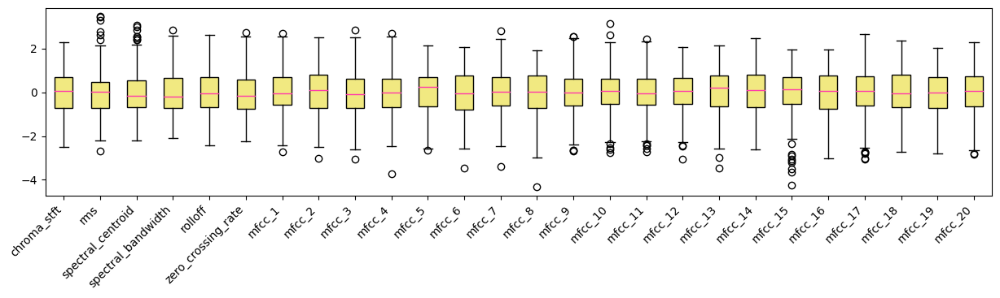

In [ ]:
# @title visualisasi setelah preprocessing
# Membuat figure dan axis dengan ukuran yang sesuai
fig, ax = plt.subplots(figsize=(15, 3))

# Menetapkan warna boxplot dan median
boxplot = ax.boxplot(df_normalized.values, patch_artist=True, boxprops=dict(facecolor='#F1E981'), medianprops=dict(color='#ff39aa'))

# Menetapkan label tick pada sumbu x
labels = df_normalized.columns
ax.set_xticklabels(labels, rotation=45, ha="right")

# Menampilkan plot
plt.show()

In [ ]:
def classify_features(df):
    categorical_features = []
    non_categorical_features = []
    discrete_features = []
    continuous_features = []

    for column in df.columns:
        if df[column].dtype == 'object':
            if df[column].nunique() < 10:
                categorical_features.append(column)
            else:
                non_categorical_features.append(column)
        elif df[column].dtype in ['int64', 'float64']:
            if df[column].nunique() < 10:
                discrete_features.append(column)
            else:
                continuous_features.append(column)

    return categorical_features, non_categorical_features, discrete_features, continuous_features
categorical, non_categorical, discrete, continuous = classify_features(data)

print("Categorical Features:", categorical)
print("Non-Categorical Features:", non_categorical)
print("Discrete Features:", discrete)
print("Continuous Features:", continuous)

Categorical Features: []
Non-Categorical Features: []
Discrete Features: ['label']
Continuous Features: ['chroma_stft', 'rms', 'spectral_centroid', 'spectral_bandwidth', 'rolloff', 'zero_crossing_rate', 'mfcc_1', 'mfcc_2', 'mfcc_3', 'mfcc_4', 'mfcc_5', 'mfcc_6', 'mfcc_7', 'mfcc_8', 'mfcc_9', 'mfcc_10', 'mfcc_11', 'mfcc_12', 'mfcc_13', 'mfcc_14', 'mfcc_15', 'mfcc_16', 'mfcc_17', 'mfcc_18', 'mfcc_19', 'mfcc_20']


In [ ]:
for i in discrete:
    print(i,':', data[i].unique())
    print()

label : [1 0]



<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


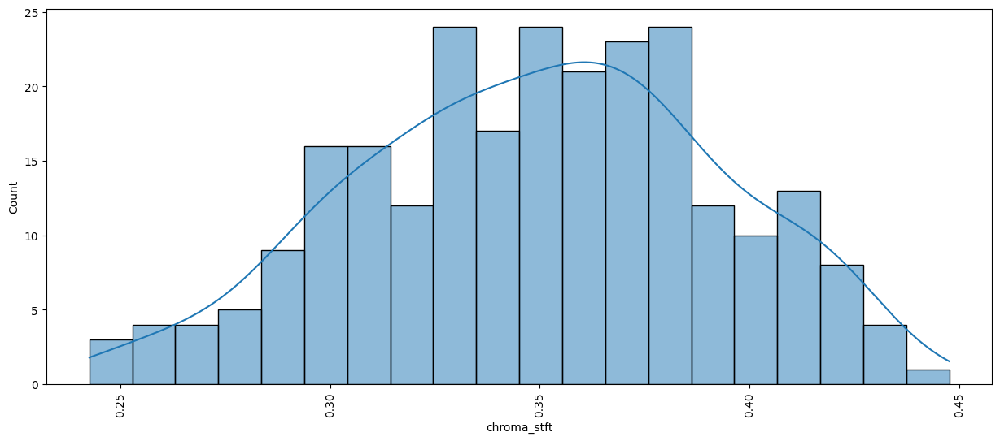

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


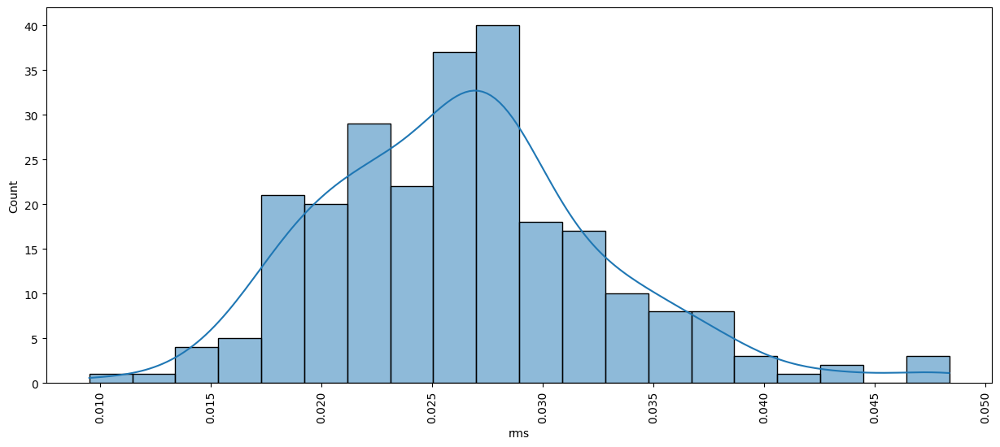

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


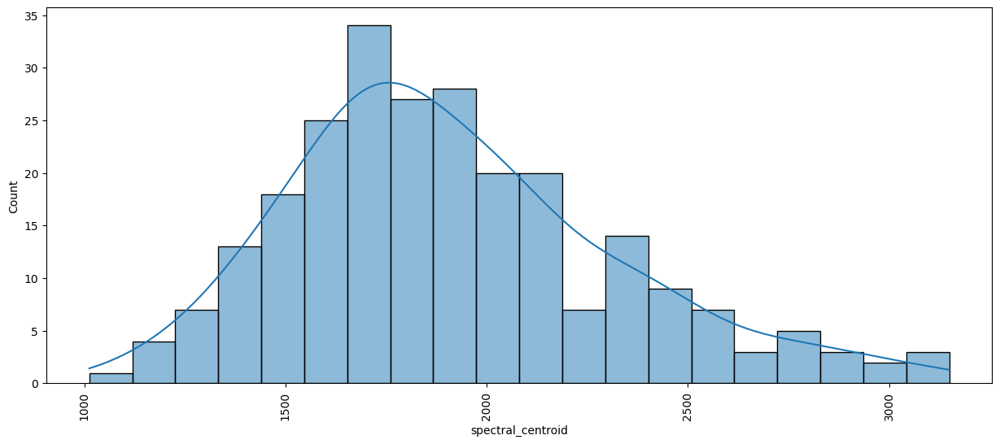

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


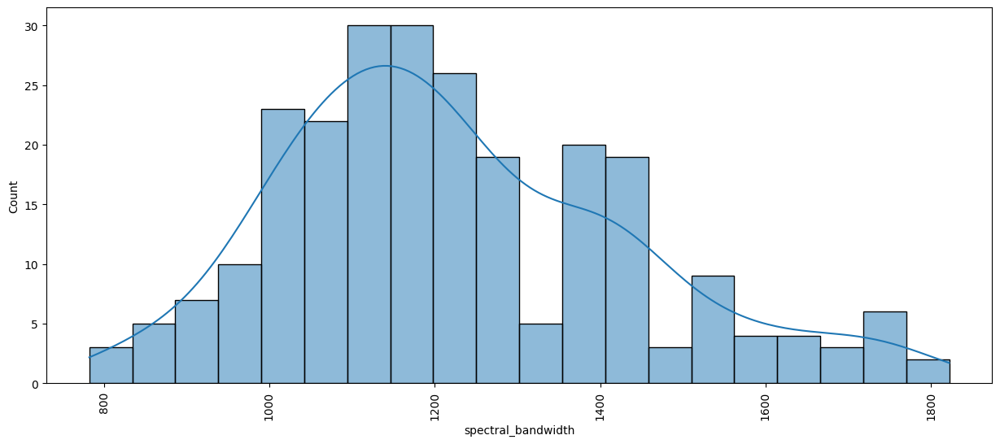

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


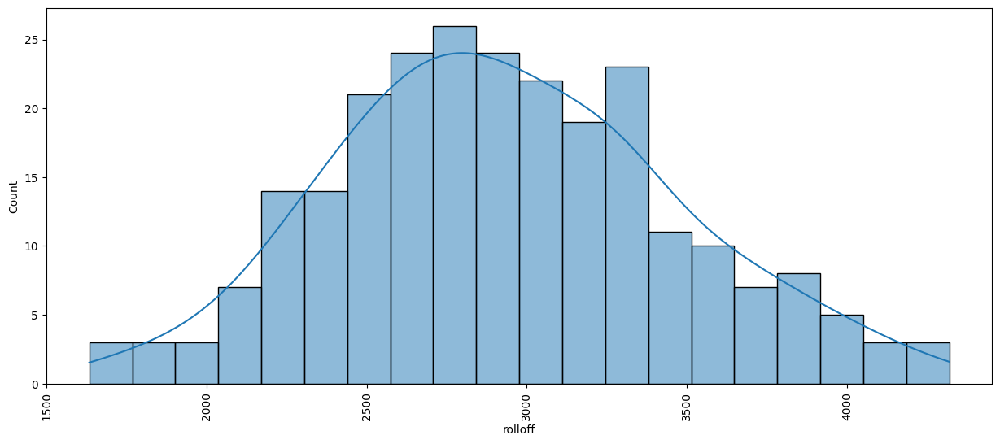

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


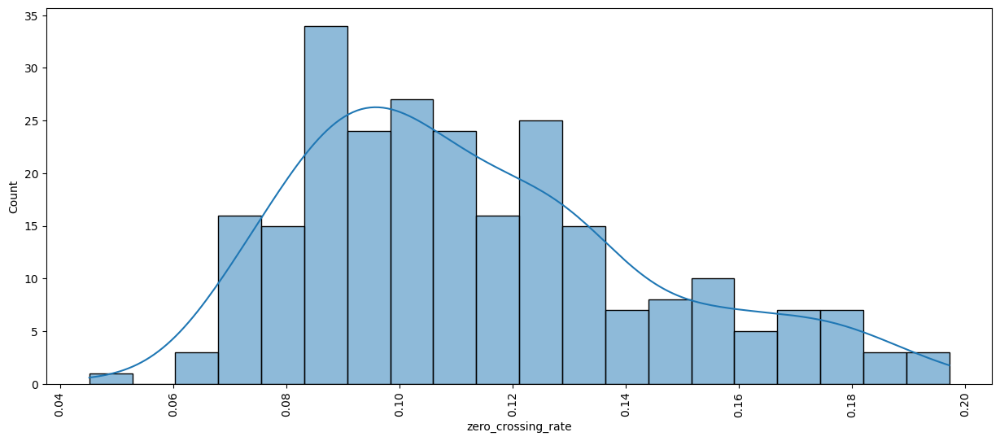

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


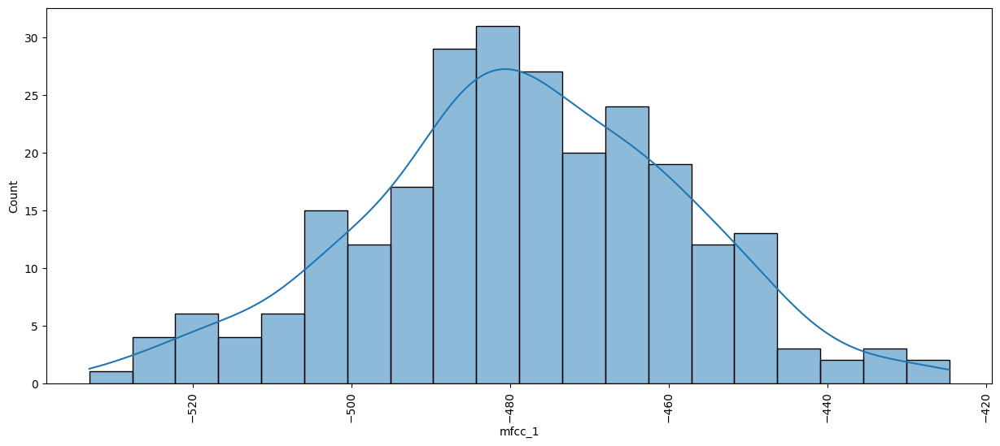

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


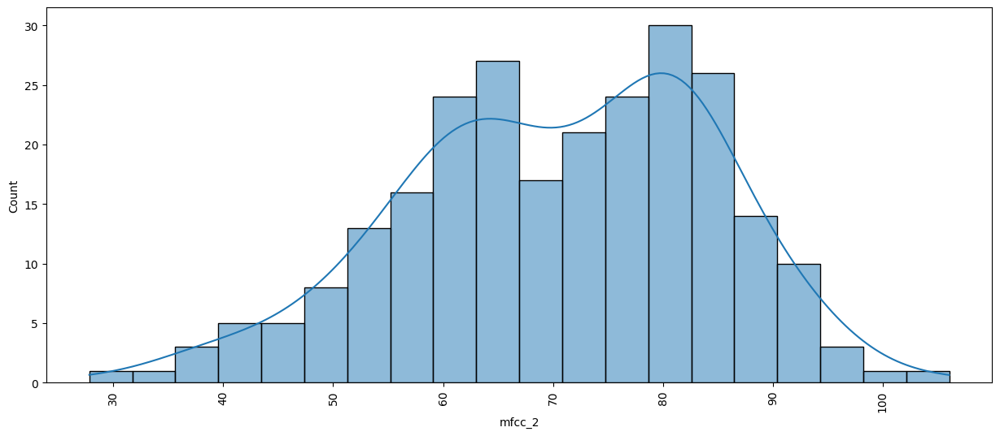

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


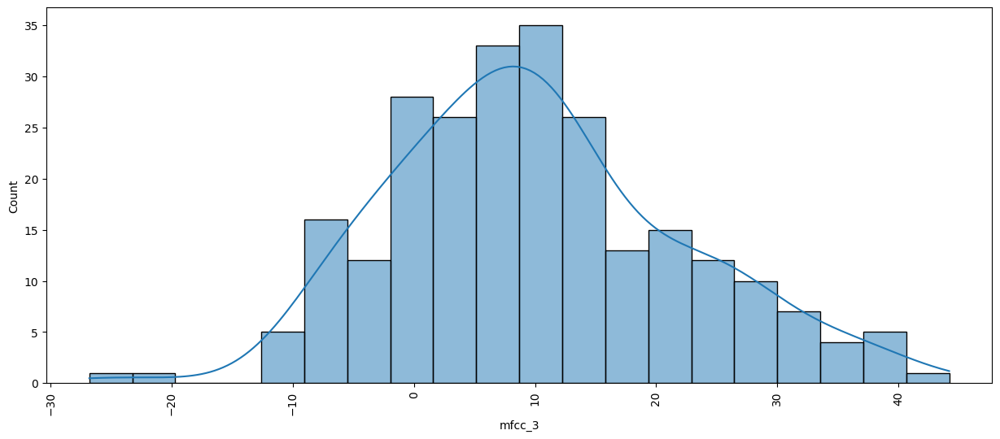

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


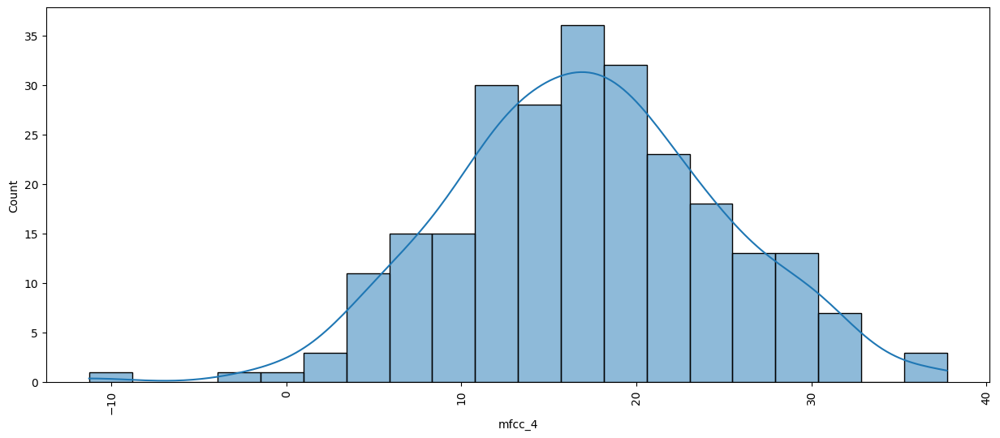

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


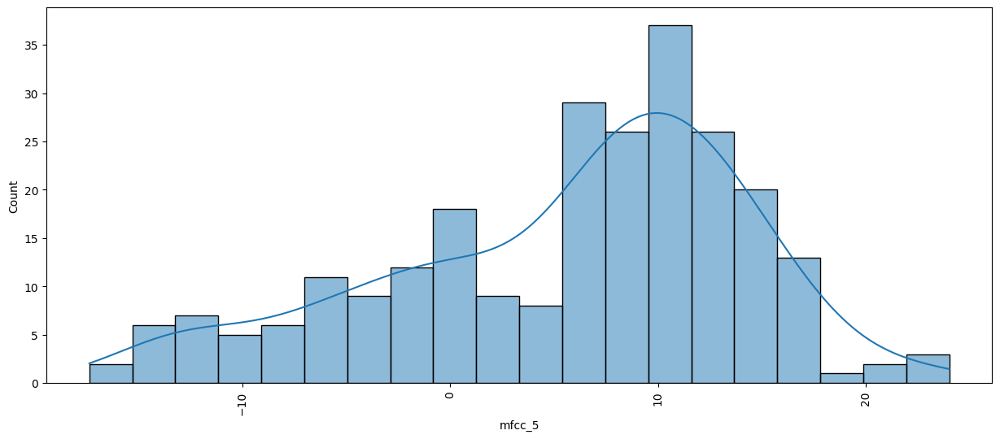

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


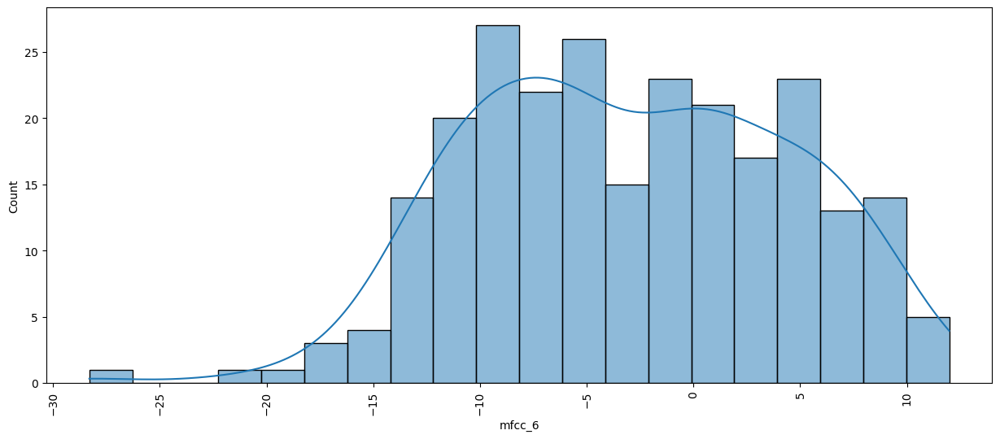

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


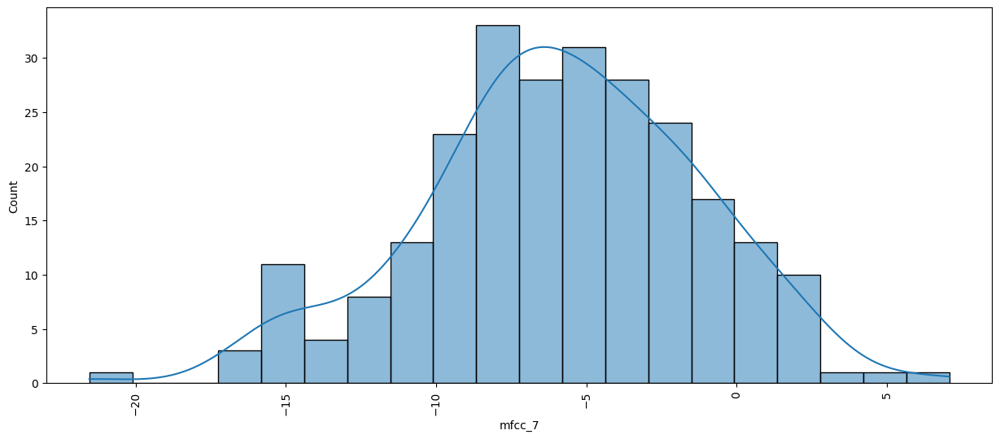

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


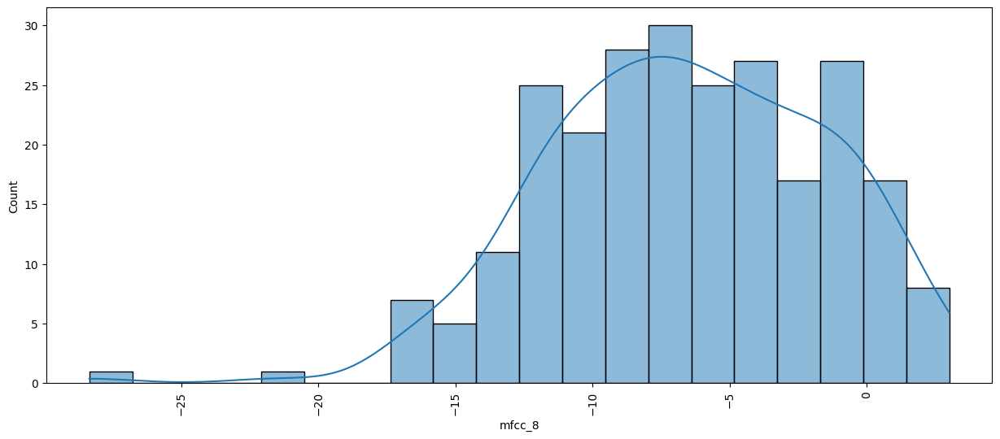

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


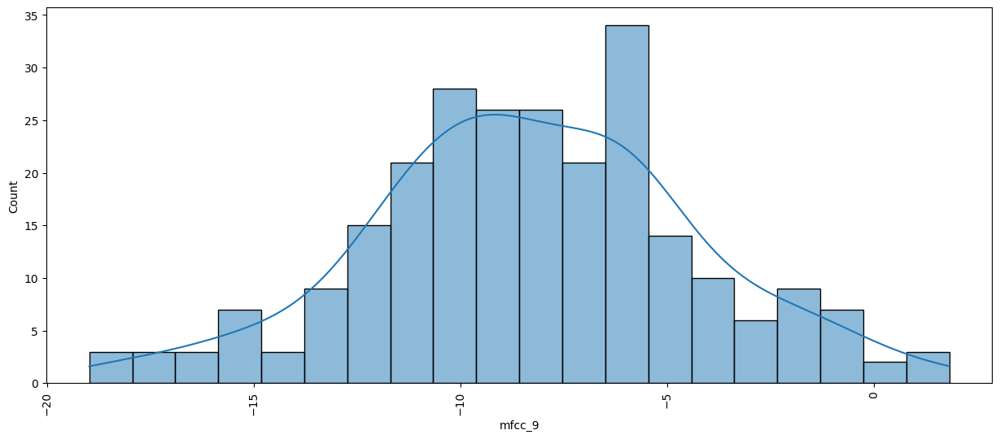

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


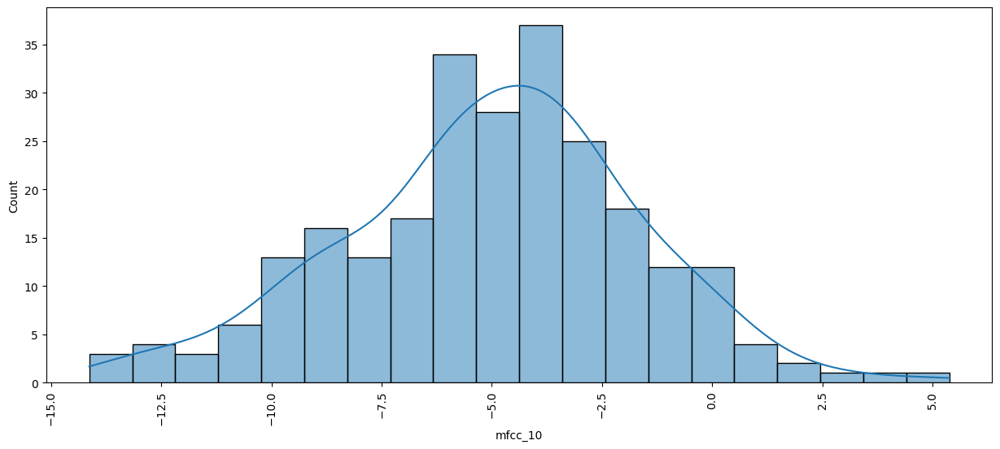

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


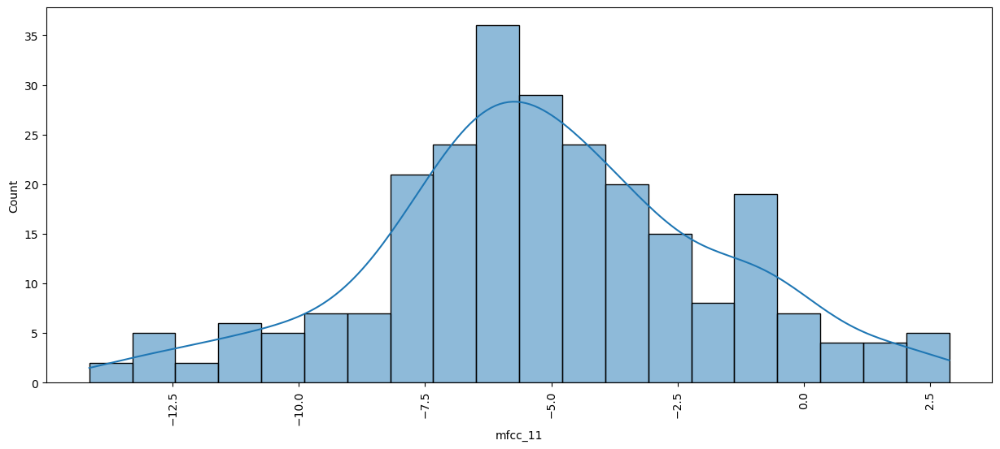

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


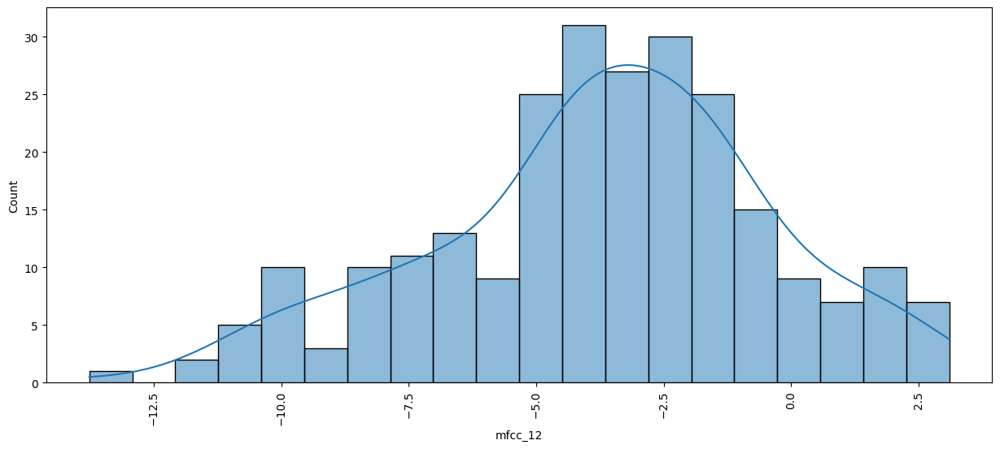

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


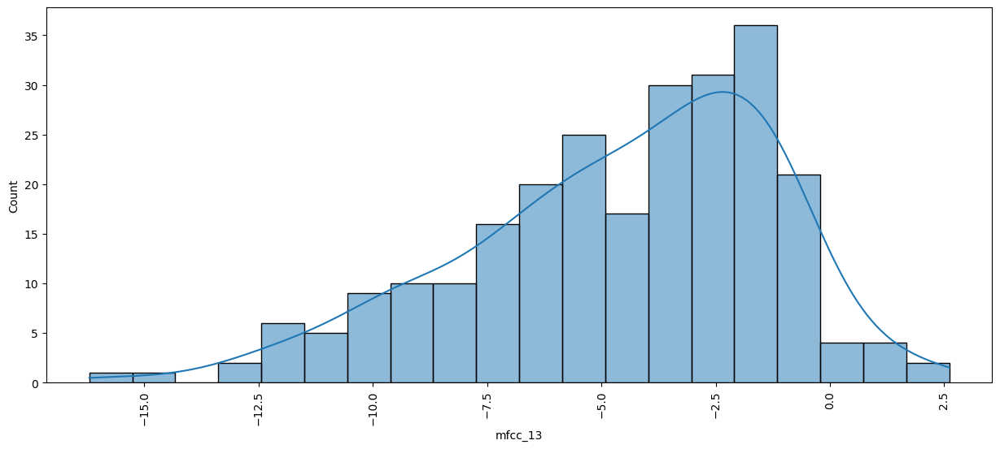

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


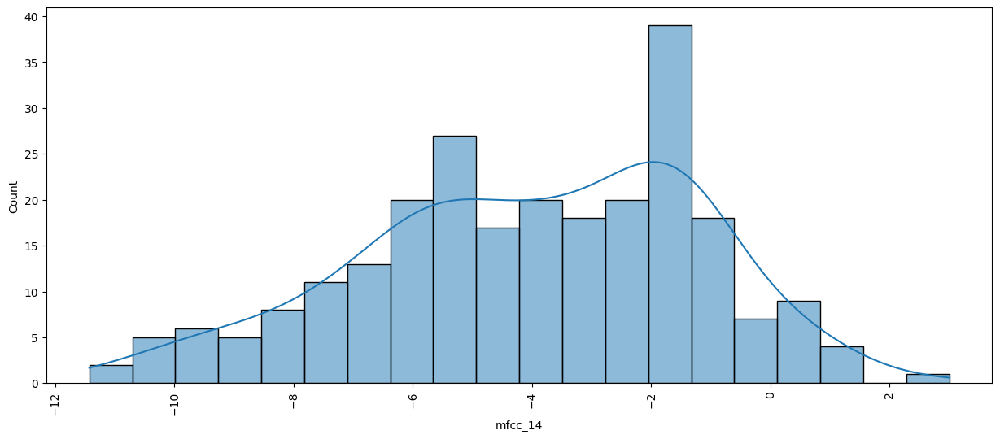

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


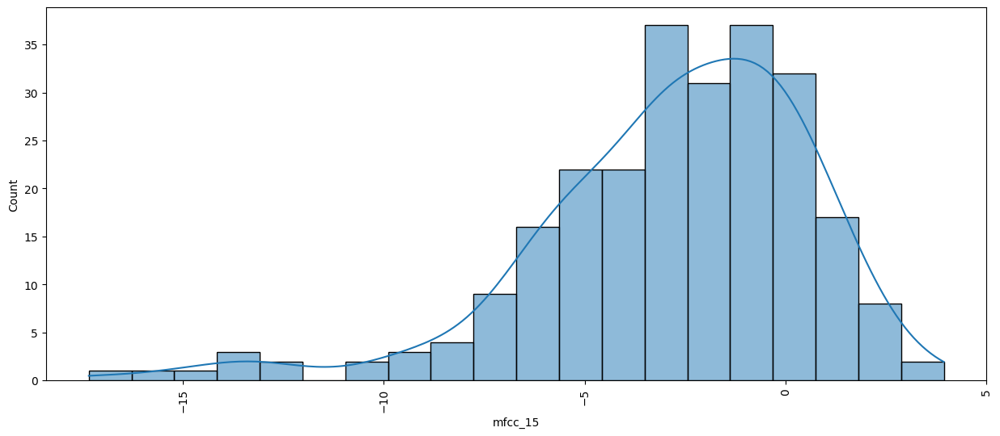

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


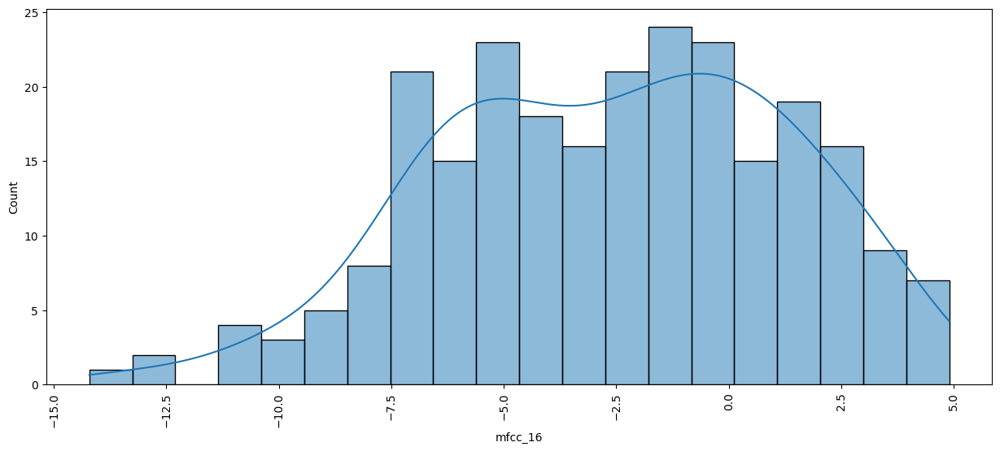

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


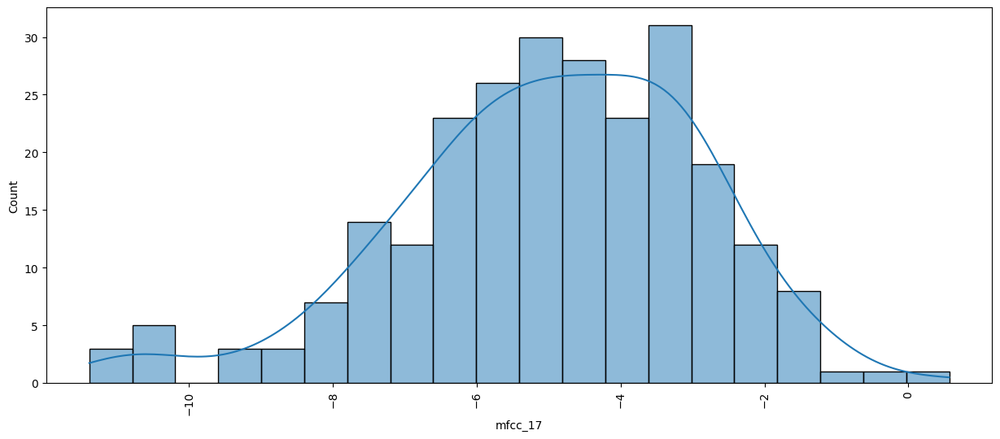

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


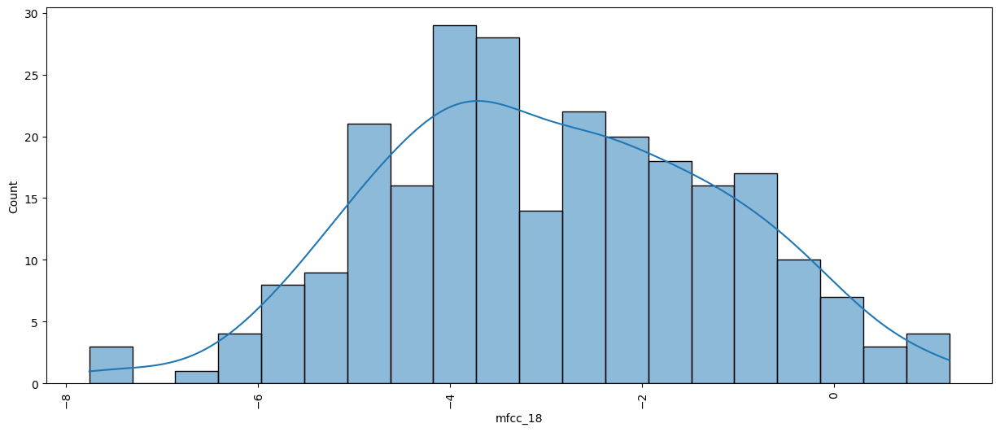

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


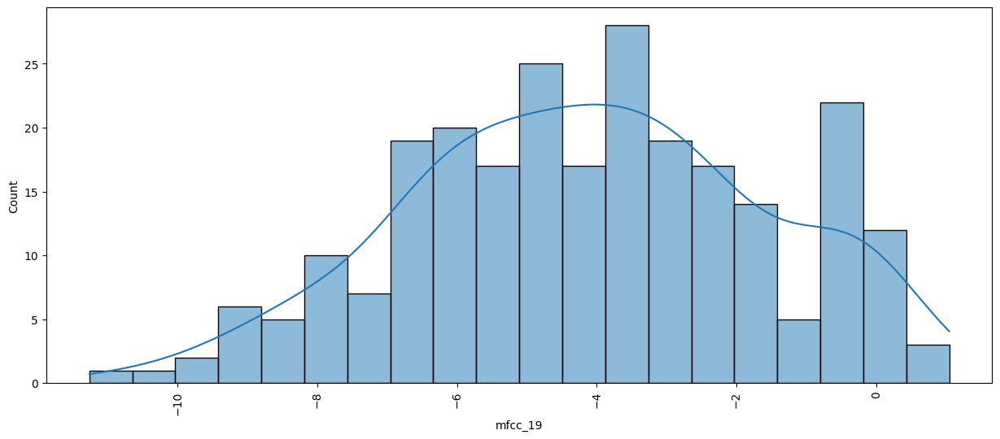

<ipython-input-89-8d6f2f97590f>:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')


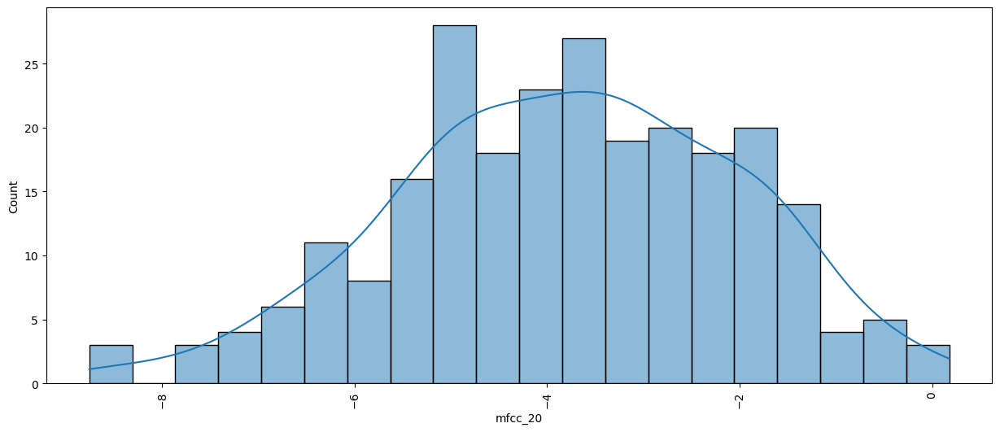

In [ ]:
for i in continuous:
    plt.figure(figsize=(15,6))
    sns.histplot(data[i], kde = True, bins = 20, palette = 'hls')
    plt.xticks(rotation = 90)
    plt.show()

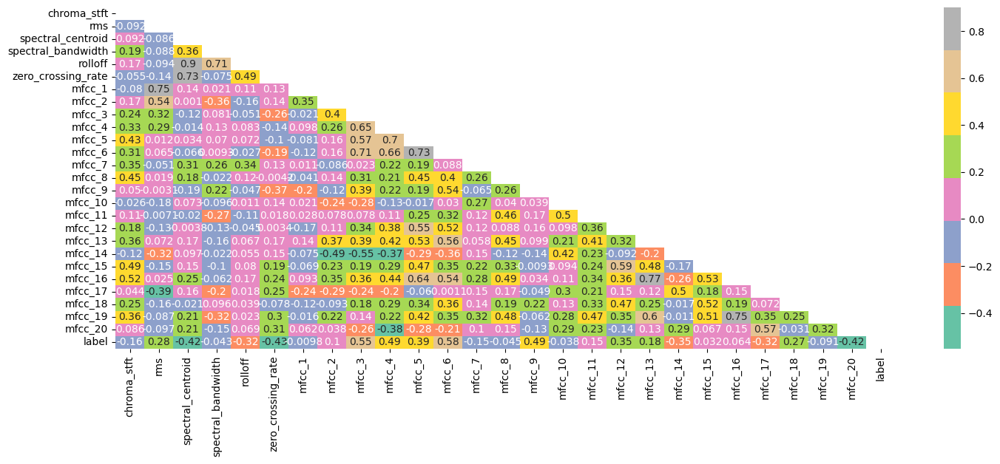

In [ ]:
lab=LabelEncoder()
for i in data.select_dtypes(include='object').columns.values:
    data[i]=lab.fit_transform(data[i])

plt.figure(figsize=(17, 6))
corr = data.corr()
my_m = np.triu(corr)
sn.heatmap(corr, mask=my_m, annot=True, cmap="Set2")
plt.show()

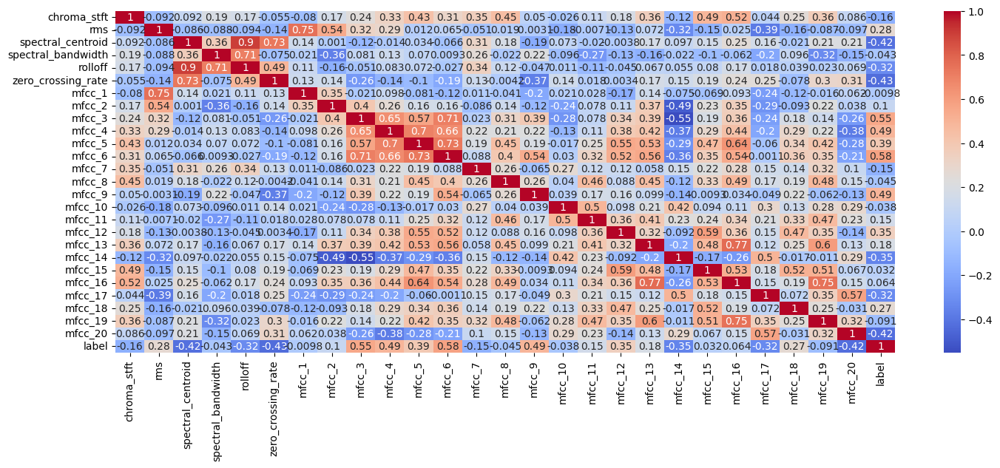

In [ ]:
plt.figure(figsize=(17, 6))
correlation_matrix = data.corr()
sn.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.show()

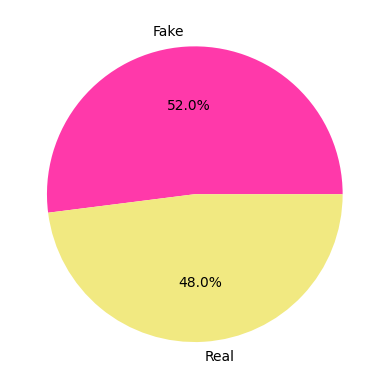

In [ ]:
df_combined = pd.concat([df_normalized, y], axis=1)

# Mengganti label kategori
label_mapping = {0: 'Fake', 1: 'Real'}
df_combined['label'] = df_combined['label'].map(label_mapping)

# Menghitung frekuensi masing-masing kategori
counts_label = df_combined['label'].value_counts()

# Mengambil kategori dan persentase
cat_label = counts_label.index
percent_label = (counts_label / len(df_combined)) * 100

# Warna pie chart
colors = ['#ff39aa', '#F1E981']

# Membuat pie chart
plt.pie(percent_label, labels=cat_label, autopct='%1.1f%%', colors=colors)

# Menampilkan plot
plt.show()

In [ ]:
counts_label

Fake    130
Real    120
Name: label, dtype: int64

In [ ]:
# @title split data
# Membagi dataset menjadi data latih dan data uji
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

scaled_X_train = X_train
scaled_X_test = X_test

scaled_X_train.shape[0]
scaled_X_test.shape[0]

50

# MODEL

## RF

In [ ]:
# @title Tuning parameter

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 10, stop = 50, num = 8)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(3, 7, num = 5)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2,3,4,5,6,7]
# Minimum number of samples required at each leaf node
min_samples_leaf = [2, 3, 4, 5]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}
print(random_grid)

{'n_estimators': [10, 15, 21, 27, 32, 38, 44, 50], 'max_features': ['auto', 'sqrt'], 'max_depth': [3, 4, 5, 6, 7, None], 'min_samples_split': [2, 3, 4, 5, 6, 7], 'min_samples_leaf': [2, 3, 4, 5], 'bootstrap': [True, False]}


In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier

# Model yang akan di-tune
rf = RandomForestClassifier(random_state = 123)

# RandomizedSearchCV untuk pencarian awal
grid_search_rf = GridSearchCV(estimator=rf, param_grid=random_grid, cv=5, scoring='accuracy')
grid_search_rf.fit(scaled_X_train, y_train)

# Melihat parameter terbaik dari RandomizedSearchCV
best_params_from_grid_rf = grid_search_rf.best_params_
best_params_from_grid_rf

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(
/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this para

{'bootstrap': True,
 'max_depth': 5,
 'max_features': 'auto',
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'n_estimators': 15}

In [ ]:
# @title build model
# Membuat model Random Forest baru dengan parameter terbaik
best_rf_model = RandomForestClassifier(
    n_estimators=best_params_from_grid_rf['n_estimators'],
    max_depth=best_params_from_grid_rf['max_depth'],
    min_samples_split=best_params_from_grid_rf['min_samples_split'],
    min_samples_leaf=best_params_from_grid_rf['min_samples_leaf'],
    max_features=best_params_from_grid_rf['max_features'],
    random_state = 123
)

# Melatih model baru dengan parameter terbaik pada seluruh dataset pelatihan
best_rf_model.fit(scaled_X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/ensemble/_forest.py:424: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'` or remove this parameter as it is also the default value for RandomForestClassifiers and ExtraTreesClassifiers.
  warn(


RandomForestClassifier(max_depth=5, max_features='auto', min_samples_leaf=3,
                       n_estimators=15, random_state=123)

In [ ]:
# @title evaluation metrics
from sklearn.metrics import accuracy_score, classification_report
# Melakukan prediksi
y_pred_rf = best_rf_model.predict(scaled_X_test)
# Evaluasi model
accuracy_rf = accuracy_score(y_test, y_pred_rf)
classification_report_output_rf = classification_report(y_test, y_pred_rf)

# Menampilkan hasil evaluasi
print("Accuracy:", accuracy_rf)
print("Classification Report:\n", classification_report_output_rf)

Accuracy: 0.92
Classification Report:
               precision    recall  f1-score   support

           0       0.88      0.96      0.92        24
           1       0.96      0.88      0.92        26

    accuracy                           0.92        50
   macro avg       0.92      0.92      0.92        50
weighted avg       0.92      0.92      0.92        50



## SVM

In [ ]:
# @title hyperparameter tuning
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
svm = SVC()
param_grid = {'C': [0.5, 1, 10, 100, 1000],
              'gamma': [0.001, 0.01, 0.1, 1],
              'kernel': ['rbf','linear']}
# Inisialisasi RandomizedSearchCV
grid_search = GridSearchCV(estimator=svm, param_grid=param_grid, cv=10, scoring='accuracy')

# Melatih model pada dataset dan menemukan parameter terbaik
grid_search.fit(scaled_X_train, y_train)

# Mendapatkan parameter terbaik dari RandomizedSearchCV
best_params_grid = grid_search.best_params_
best_params_grid

{'C': 1, 'gamma': 0.01, 'kernel': 'rbf'}

In [ ]:
# @title build model
# Initialize a new SVM model with the best parameters
best_svm_model = SVC(**best_params_grid)

# Fit the new model on the entire training dataset
best_svm_model.fit(scaled_X_train, y_train)

SVC(C=1, gamma=0.01)

In [ ]:
# @title evaluation metrics
from sklearn.metrics import accuracy_score, classification_report
# Melakukan prediksi
y_pred_svm = best_svm_model.predict(scaled_X_test)
# Evaluasi model
accuracy_svm = accuracy_score(y_test, y_pred_svm)
classification_report_output_svm = classification_report(y_test, y_pred_svm)

# Menampilkan hasil evaluasi
print("Accuracy:", accuracy_svm)
print("Classification Report:\n", classification_report_output_svm)

Accuracy: 0.94
Classification Report:
               precision    recall  f1-score   support

           0       0.89      1.00      0.94        24
           1       1.00      0.88      0.94        26

    accuracy                           0.94        50
   macro avg       0.94      0.94      0.94        50
weighted avg       0.95      0.94      0.94        50



In [ ]:
def calculate_confusion_matrix(y_test, y_pred_svm):
    TP = TN = FP = FN = 0

    for true, pred in zip(y_test, y_pred_svm):
        if true == 1 and pred == 1:
            TP += 1
        elif true == 0 and pred == 0:
            TN += 1
        elif true == 0 and pred == 1:
            FP += 1
        elif true == 1 and pred == 0:
            FN += 1

    return TP, TN, FP, FN


TP, TN, FP, FN = calculate_confusion_matrix(y_test, y_pred_svm)

print(f"True Positive (TP): {TP}")
print(f"True Negative (TN): {TN}")
print(f"False Positive (FP): {FP}")
print(f"False Negative (FN): {FN}")


True Positive (TP): 23
True Negative (TN): 24
False Positive (FP): 0
False Negative (FN): 3


## MLP

In [ ]:
from sklearn.neural_network import MLPClassifier

# Buat objek MLPClassifier
mlp = MLPClassifier()

# Dapatkan parameter dari model
params = mlp.get_params()

# Tampilkan parameter
print("Parameter MLPClassifier:")
for key, value in params.items():
    print(f"{key}: {value}")


Parameter MLPClassifier:
activation: relu
alpha: 0.0001
batch_size: auto
beta_1: 0.9
beta_2: 0.999
early_stopping: False
epsilon: 1e-08
hidden_layer_sizes: (100,)
learning_rate: constant
learning_rate_init: 0.001
max_fun: 15000
max_iter: 200
momentum: 0.9
n_iter_no_change: 10
nesterovs_momentum: True
power_t: 0.5
random_state: None
shuffle: True
solver: adam
tol: 0.0001
validation_fraction: 0.1
verbose: False
warm_start: False


In [ ]:
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
import numpy as np

# Tentukan model MLPClassifier
mlp_classifier = MLPClassifier(random_state = 40)

# Tentukan ruang parameter yang akan dijelajahi
param_grid_MLP = {
    'hidden_layer_sizes': [(25,), (35,), (45)],
    'activation': ['relu', 'tanh', 'logistic'],
    'learning_rate': ['constant', 'invscaling', 'adaptive'],
    'alpha': [0.001, 0.01, 0.1],
    'solver': ['adam', 'sgd'],
    'max_iter': [50, 100, 150],
}

# Gunakan RandomizedSearchCV untuk mencari parameter terbaik
grid_search_mlp = GridSearchCV(estimator=mlp_classifier, param_grid=param_grid_MLP, cv=5, scoring='accuracy')
grid_search_mlp.fit(scaled_X_train, y_train)

# Lihat parameter terbaik dari RandomizedSearchCV
best_params_from_grid_mlp = grid_search_mlp.best_params_
best_params_from_grid_mlp

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (50) reached and the optimization hasn't converged yet.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py

{'activation': 'tanh',
 'alpha': 0.001,
 'hidden_layer_sizes': 45,
 'learning_rate': 'constant',
 'max_iter': 150,
 'solver': 'adam'}

In [ ]:
# @title build model
from sklearn.neural_network import MLPClassifier

# Buat MLPClassifier dengan parameter terbaik dari GridSearchCV
best_mlp_classifier = MLPClassifier(
    hidden_layer_sizes=best_params_from_grid_mlp['hidden_layer_sizes'],
    activation=best_params_from_grid_mlp['activation'],
    learning_rate=best_params_from_grid_mlp['learning_rate'],
    alpha=best_params_from_grid_mlp['alpha'],
    solver=best_params_from_grid_mlp['solver'],
    max_iter=best_params_from_grid_mlp['max_iter'],
    random_state = 40

)

# Latih model dengan data pelatihan yang telah discaling
best_mlp_classifier.fit(scaled_X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:686: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (150) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPClassifier(activation='tanh', alpha=0.001, hidden_layer_sizes=45,
              max_iter=150, random_state=40)

In [ ]:
# @title evaluation metrics
from sklearn.metrics import accuracy_score, classification_report
# Melakukan prediksi
y_pred_MLP = best_mlp_classifier.predict(scaled_X_test)
# Evaluasi model
accuracy_MLP = accuracy_score(y_test, y_pred_MLP)
classification_report_output_MLP= classification_report(y_test, y_pred_MLP)

# Menampilkan hasil evaluasi
print("Accuracy:", accuracy_MLP)
print("Classification Report:\n", classification_report_output_MLP)

Accuracy: 0.92
Classification Report:
               precision    recall  f1-score   support

           0       0.86      1.00      0.92        24
           1       1.00      0.85      0.92        26

    accuracy                           0.92        50
   macro avg       0.93      0.92      0.92        50
weighted avg       0.93      0.92      0.92        50



## KNN

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
# Tentukan rentang nilai untuk setiap parameter yang ingin diuji

n_neighbors = [5,6,7,8,]
print(n_neighbors)
param_grid_knn = {
    'n_neighbors': n_neighbors,
    'weights': ['uniform', 'distance'],
    'metric': ['euclidean', 'manhattan'],
    'p': [1, 2]
}
# Inisialisasi model KNN
knn = KNeighborsClassifier()

# Buat objek GridSearchCV
grid_search_knn = GridSearchCV(estimator=knn, param_grid=param_grid_knn, cv=5, scoring='accuracy')

# Lakukan Grid Search pada data latih
grid_search_knn.fit(scaled_X_train, y_train)
# View the best parameters from RandomizedSearchCV
best_params_from_grid_knn = grid_search_knn.best_params_
best_params_from_grid_knn

[5, 6, 7, 8]


{'metric': 'euclidean', 'n_neighbors': 6, 'p': 1, 'weights': 'uniform'}

In [ ]:
# @title build model
knn_model = KNeighborsClassifier(
    n_neighbors=best_params_from_grid_knn['n_neighbors'],
    weights = best_params_from_grid_knn['weights'],
    metric = best_params_from_grid_knn['metric'],
    p = best_params_from_grid_knn['p'],
    )
knn_model.fit(scaled_X_train, y_train)

KNeighborsClassifier(metric='euclidean', n_neighbors=6, p=1)

In [ ]:
# @title evaluation metrics
from sklearn.metrics import accuracy_score, classification_report
# Melakukan prediksi
y_pred_knn = knn_model.predict(scaled_X_test)

accuracy_knn = accuracy_score(y_test, y_pred_knn)
print("Accuracy:", accuracy_knn)

# Print classification report
classification_report_output_knn = classification_report(y_test, y_pred_knn)
print("Classification Report:\n", classification_report_output_knn)

Accuracy: 0.84
Classification Report:
               precision    recall  f1-score   support

           0       0.75      1.00      0.86        24
           1       1.00      0.69      0.82        26

    accuracy                           0.84        50
   macro avg       0.88      0.85      0.84        50
weighted avg       0.88      0.84      0.84        50



## DT

In [ ]:
from sklearn.tree import DecisionTreeClassifier

# Buat objek MLPClassifier
dt = DecisionTreeClassifier()

# Dapatkan parameter dari model
params = dt.get_params()

# Tampilkan parameter
print("Parameter MLPClassifier:")
for key, value in params.items():
    print(f"{key}: {value}")


Parameter MLPClassifier:
ccp_alpha: 0.0
class_weight: None
criterion: gini
max_depth: None
max_features: None
max_leaf_nodes: None
min_impurity_decrease: 0.0
min_samples_leaf: 1
min_samples_split: 2
min_weight_fraction_leaf: 0.0
random_state: None
splitter: best


In [ ]:
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.tree import DecisionTreeClassifier
import numpy as np

# Number of features to consider at every split
max_features_dt = ['auto', 'sqrt']

# Maximum number of levels in tree
max_depth_dt = [int(x) for x in np.linspace(10, 25, num=7)]
max_depth_dt.append(None)

# Minimum number of samples required to split a node
min_samples_split_dt = [2, 3, 4, 5, 6]

# Minimum number of samples required at each leaf node
min_samples_leaf_dt = [2, 3, 4, 5, 6]

# Criterion for quality of split
criterion_dt = ['gini', 'entropy']

# Complexity parameter used for Minimal Cost-Complexity Pruning (ccp)
ccp_alpha_dt = [0.001, 0.05, 0.02, 0.01, 0.1]

splitter_dt = ['best', 'random']

# Create the random grid
random_grid_dt = {
    'max_features': max_features_dt,
    'max_depth': max_depth_dt,
    'min_samples_split': min_samples_split_dt,
    'min_samples_leaf': min_samples_leaf_dt,
    'criterion': criterion_dt,
    'ccp_alpha': ccp_alpha_dt,
    'splitter' : splitter_dt
}

# Create a DecisionTreeClassifier
dt_classifier = DecisionTreeClassifier(random_state=0)

# Use RandomizedSearchCV to find the best parameters
grid_search_dt = GridSearchCV(estimator=dt_classifier, param_grid=random_grid_dt, cv=5, scoring='accuracy')
grid_search_dt.fit(scaled_X_train, y_train)

# View the best parameters from RandomizedSearchCV
best_params_from_grid_dt = grid_search_dt.best_params_
best_params_from_grid_dt

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_feat

{'ccp_alpha': 0.05,
 'criterion': 'entropy',
 'max_depth': 10,
 'max_features': 'auto',
 'min_samples_leaf': 3,
 'min_samples_split': 2,
 'splitter': 'best'}

In [ ]:
# @title build model
# Buat Decision Tree Classifier dengan parameter terbaik dari GridSearchCV
best_dt_classifier = DecisionTreeClassifier(
    max_depth=best_params_from_grid_dt['max_depth'],
    min_samples_split=best_params_from_grid_dt['min_samples_split'],
    min_samples_leaf=best_params_from_grid_dt['min_samples_leaf'],
    max_features=best_params_from_grid_dt['max_features'],
    criterion=best_params_from_grid_dt['criterion'],
    ccp_alpha=best_params_from_grid_dt['ccp_alpha'],
    random_state=0
)

# Training model dengan data pelatihan yang telah discaling
best_dt_classifier.fit(scaled_X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/tree/_classes.py:269: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features='sqrt'`.
  warnings.warn(


DecisionTreeClassifier(ccp_alpha=0.05, criterion='entropy', max_depth=10,
                       max_features='auto', min_samples_leaf=3, random_state=0)

In [ ]:
# @title evaluation metrics
from sklearn.metrics import accuracy_score, classification_report
# Melakukan prediksi
y_pred_dt = best_dt_classifier.predict(scaled_X_test)
# Evaluasi model
accuracy_dt = accuracy_score(y_test, y_pred_dt)
classification_report_output_dt = classification_report(y_test, y_pred_dt)

# Menampilkan hasil evaluasi
print("Accuracy:", accuracy_dt)
print("Classification Report:\n", classification_report_output_dt)

Accuracy: 0.86
Classification Report:
               precision    recall  f1-score   support

           0       0.84      0.88      0.86        24
           1       0.88      0.85      0.86        26

    accuracy                           0.86        50
   macro avg       0.86      0.86      0.86        50
weighted avg       0.86      0.86      0.86        50



# Perbandingan Model

In [ ]:
from sklearn.metrics import accuracy_score
import pandas as pd

# Contoh data evaluasi
data = {
    'Model': ['Random Forest', 'SVM', 'K-NN', 'Decision Tree', 'MLP'],
}

# Membuat DataFrame
df = pd.DataFrame(data)

# List untuk menyimpan nilai akurasi
accuracy_scores = []

# Iterate over models and calculate accuracy
for model in df['Model']:
    if model == 'Random Forest':
        y_true = y_test
        y_pred = y_pred_rf
    elif model == 'SVM':
        y_true = y_test
        y_pred = y_pred_svm
    elif model == 'K-NN':
        y_true = y_test
        y_pred = y_pred_knn
    elif model == 'Decision Tree':
        y_true = y_test
        y_pred = y_pred_dt
    elif model == 'MLP':
        y_true = y_test
        y_pred = y_pred_MLP

    accuracy = accuracy_score(y_true, y_pred)
    accuracy_scores.append(accuracy)

# Membuat DataFrame dari nilai akurasi
df_accuracy = pd.DataFrame({
    'Model': df['Model'],
    'Accuracy': accuracy_scores
})

# Menampilkan DataFrame
print(df_accuracy)


           Model  Accuracy
0  Random Forest      0.92
1            SVM      0.94
2           K-NN      0.84
3  Decision Tree      0.86
4            MLP      0.92


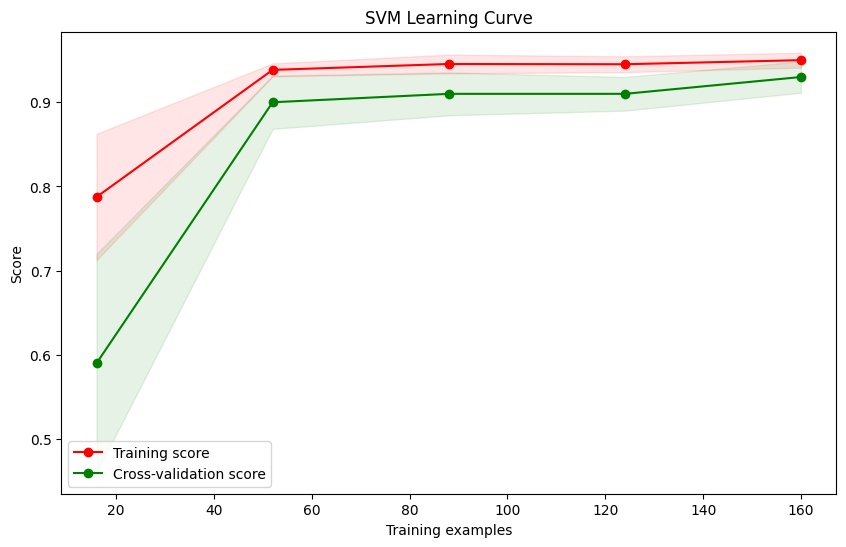

In [ ]:
# Fungsi untuk membuat grafik kurva pembelajaran untuk SVM
from sklearn.model_selection import learning_curve
def plot_learning_curve_svm(model, title, X, y, cv=None, n_jobs=-1, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure(figsize=(10, 6))
    plt.title(title)
    plt.xlabel("Training examples")
    plt.ylabel("Score")

    train_sizes, train_scores, test_scores = learning_curve(
        model, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes, scoring='accuracy'
    )

    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

# Plotting learning curve for the best SVM model
plot_learning_curve_svm(best_svm_model, "SVM Learning Curve", scaled_X_train, y_train, cv=5, n_jobs=-1)

plt.show()


# Membuat Fungsi Untuk Demo

In [ ]:
def preprocessing(audio, sampling_rate):
  # Resample audio
  audio_resampled = librosa.resample(audio, orig_sr=sampling_rate, target_sr=22050)

  # Normalize audio
  audio_normalized = audio_resampled / np.max(np.abs(audio_resampled))

  #Reduce audio noise
  reduced_noise = nr.reduce_noise(y=audio_normalized, sr=22050)

  return reduced_noise

In [ ]:
def feature(reduced_noise):
  # Extract features
  chroma_stft = np.mean(librosa.feature.chroma_stft(y=reduced_noise, sr=22050))
  rms = np.mean(librosa.feature.rms(y=reduced_noise))
  spectral_centroid = np.mean(librosa.feature.spectral_centroid(y=reduced_noise, sr=22050))
  spectral_bandwidth = np.mean(librosa.feature.spectral_bandwidth(y=reduced_noise, sr=22050))
  rolloff = np.mean(librosa.feature.spectral_rolloff(y=reduced_noise, sr=22050))
  zero_crossing_rate = np.mean(librosa.feature.zero_crossing_rate(y=reduced_noise))
  mfcc = np.mean(librosa.feature.mfcc(y=reduced_noise, sr=22050, n_mfcc=20), axis=1)

  # Create a DataFrame with extracted features
  feature_df = pd.DataFrame({
      'chroma_stft': [chroma_stft],
      'rms': [rms],
      'spectral_centroid': [spectral_centroid],
      'spectral_bandwidth': [spectral_bandwidth],
      'rolloff': [rolloff],
      'zero_crossing_rate': [zero_crossing_rate],
  })

  # Add MFCC values to the DataFrame
  mfcc_df = pd.DataFrame([mfcc], columns=[f'mfcc_{i}' for i in range(1, 21)])
  feature_df = pd.concat([feature_df, mfcc_df], axis=1)

  #Normalize
  data_normalized = pipeline.transform(feature_df)

  return data_normalized

In [ ]:
# @title svm
def detect_deepfake_svm(data_normalized):

  # Predict using the trained model
  predictions = best_svm_model.predict(data_normalized)

  # Convert numerical predictions to labels (REAL or FAKE)
  result = "REAL" if predictions[0] == 1 else "FAKE"

  return f"YOUR AUDIO IS {result}"

In [ ]:
# @title mlp
def detect_deepfake_mlp(data_normalized):

  # Predict using the trained model
  predictions = best_mlp_classifier.predict(data_normalized)

  # Convert numerical predictions to labels (REAL or FAKE)
  result = "REAL" if predictions[0] == 1 else "FAKE"

  return f"YOUR AUDIO IS {result}"

In [ ]:
# @title rf
def detect_deepfake_rf(data_normalized):

  # Predict using the trained model
  predictions = best_rf_model.predict(data_normalized)

  # Convert numerical predictions to labels (REAL or FAKE)
  result = "REAL" if predictions[0] == 1 else "FAKE"

  return f"YOUR AUDIO IS {result}"

In [ ]:
# @title knn
def detect_deepfake_knn(data_normalized):

  # Predict using the trained model
  predictions = knn_model.predict(data_normalized)

  # Convert numerical predictions to labels (REAL or FAKE)
  result = "REAL" if predictions[0] == 1 else "FAKE"

  return f"YOUR AUDIO IS {result}"

In [ ]:
# @title dt
def detect_deepfake_dt(data_normalized):

  # Predict using the trained model
  predictions = best_dt_classifier.predict(data_normalized)

  # Convert numerical predictions to labels (REAL or FAKE)
  result = "REAL" if predictions[0] == 1 else "FAKE"

  return f"YOUR AUDIO IS {result}"

# DEMO

In [ ]:
    "MLP": detect_deepfake_mlp,
    "Random Forest": detect_deepfake_rf,
    "KNN": detect_deepfake_knn,
    "Decision Tree": detect_deepfake_dt,

Real Audio

In [ ]:
# Load the original audio
real_sample, sample_rate = librosa.load("/content/Eps 322 - Harusnya kita masih temenan (mp3cut.net).wav")

# Use your preprocess function (detect_deepfake_svm)
reduced_noise = preprocessing(real_sample, sample_rate)
data_normalized = feature(reduced_noise)

models = {
    "SVM": detect_deepfake_svm
}

# Display the original audio
print("Original Audio:")
ipd.display(ipd.Audio(real_sample, rate=sample_rate))

# Display the preprocessed audio
print("Preprocessed Audio:")
ipd.display(ipd.Audio(reduced_noise, rate=22050))

# Display the result
for model_name, model_function in models.items():
    result = model_function(data_normalized)
    print(f"Classification Result ({model_name}): {result}")


Original Audio:


Preprocessed Audio:


Classification Result (SVM): YOUR AUDIO IS REAL


In [ ]:
# Load the original audio
real_sample, sample_rate = librosa.load("/content/Eps 323 - Kita terlalu asing (mp3cut.net).wav")

# Use your preprocess function (detect_deepfake_svm)
reduced_noise = preprocessing(real_sample, sample_rate)
data_normalized = feature(reduced_noise)

models = {
    "SVM": detect_deepfake_svm
}

# Display the original audio
print("Original Audio:")
ipd.display(ipd.Audio(real_sample, rate=sample_rate))

# Display the preprocessed audio
print("Preprocessed Audio:")
ipd.display(ipd.Audio(reduced_noise, rate=22050))

# Display the result
for model_name, model_function in models.items():
    result = model_function(data_normalized)
    print(f"Classification Result ({model_name}): {result}")

Original Audio:


Preprocessed Audio:


Classification Result (SVM): YOUR AUDIO IS REAL


In [ ]:
# Load the original audio
real_sample, sample_rate = librosa.load("/content/Eps 324 - Aku sampai di sini dulu ya (mp3cut.net).wav")

# Use your preprocess function (detect_deepfake_svm)
reduced_noise = preprocessing(real_sample, sample_rate)
data_normalized = feature(reduced_noise)

models = {
    "SVM": detect_deepfake_svm
}

# Display the original audio
print("Original Audio:")
ipd.display(ipd.Audio(real_sample, rate=sample_rate))

# Display the preprocessed audio
print("Preprocessed Audio:")
ipd.display(ipd.Audio(reduced_noise, rate=22050))

# Display the result
for model_name, model_function in models.items():
    result = model_function(data_normalized)
    print(f"Classification Result ({model_name}): {result}")

Original Audio:


Preprocessed Audio:


Classification Result (SVM): YOUR AUDIO IS REAL


Fake Audio

In [ ]:
# Load the original audio
real_sample, sample_rate = librosa.load("/content/Eps 322 - Harusnya kita masih temenan-metavoice-eva.wav")

# Use your preprocess function (detect_deepfake_svm)
reduced_noise = preprocessing(real_sample, sample_rate)
data_normalized = feature(reduced_noise)

models = {
    "SVM": detect_deepfake_svm
}

# Display the original audio
print("Original Audio:")
ipd.display(ipd.Audio(real_sample, rate=sample_rate))

# Display the preprocessed audio
print("Preprocessed Audio:")
ipd.display(ipd.Audio(reduced_noise, rate=22050))

# Display the result
for model_name, model_function in models.items():
    result = model_function(data_normalized)
    print(f"Classification Result ({model_name}): {result}")

Original Audio:


Preprocessed Audio:


Classification Result (SVM): YOUR AUDIO IS FAKE


In [ ]:
# Load the original audio
real_sample, sample_rate = librosa.load("/content/Eps 323 - Kita terlalu asing-metavoice-dex.wav")

# Use your preprocess function (detect_deepfake_svm)
reduced_noise = preprocessing(real_sample, sample_rate)
data_normalized = feature(reduced_noise)

models = {
    "SVM": detect_deepfake_svm
}

# Display the original audio
print("Original Audio:")
ipd.display(ipd.Audio(real_sample, rate=sample_rate))

# Display the preprocessed audio
print("Preprocessed Audio:")
ipd.display(ipd.Audio(reduced_noise, rate=22050))

# Display the result
for model_name, model_function in models.items():
    result = model_function(data_normalized)
    print(f"Classification Result ({model_name}): {result}")

Original Audio:


Preprocessed Audio:


Classification Result (SVM): YOUR AUDIO IS FAKE


In [ ]:
# Load the original audio
real_sample, sample_rate = librosa.load("/content/Eps 324 - Aku sampai di sini dulu ya-metavoice-aurora.wav")

# Use your preprocess function (detect_deepfake_svm)
reduced_noise = preprocessing(real_sample, sample_rate)
data_normalized = feature(reduced_noise)

models = {
    "SVM": detect_deepfake_svm
}

# Display the original audio
print("Original Audio:")
ipd.display(ipd.Audio(real_sample, rate=sample_rate))

# Display the preprocessed audio
print("Preprocessed Audio:")
ipd.display(ipd.Audio(reduced_noise, rate=22050))

# Display the result
for model_name, model_function in models.items():
    result = model_function(data_normalized)
    print(f"Classification Result ({model_name}): {result}")

Original Audio:


Preprocessed Audio:


Classification Result (SVM): YOUR AUDIO IS FAKE
